# Introduction

This file is meant to evaluate and extract explanations of the DARWIN dataset using the Stratified K-Fold with 10 train/test partitions. In each partition, the classifiers are trained with the hyperparameters obtained by applying Grid Search. This file is useful to get a better ideia of the real performance of the models by reducing the impact of randomness that a single train/test partition may cause.

Note: The complete run of this file should take 0.5-1.5 hours.

# Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json
from ucimlrepo import fetch_ucirepo
from sklearn.compose import make_column_selector as selector
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
import lime.lime_tabular
import shap
from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from DatasetAnalysis import DatasetAnalysis
from PerformanceAnalysis import PerformanceAnalysis
from Visualization import Visualization
import os

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Setup

In [2]:
config_file = open('configs\\config.json')
config_vars = json.load(config_file)
config_file.close()

logs_dir = config_vars["logs_dir"] + "/darwin_CV_GS"
dataset_dir = config_vars["dataset_dir"] + "/DARWIN.csv"

if not os.path.exists(logs_dir):
    os.makedirs(logs_dir)

In [3]:
config_file = open('configs\\visual_config.json')
visual_vars = json.load(config_file)
config_file.close()

shap_colors_neg = visual_vars["shap_colors"]["negative"]
shap_colors_pos = visual_vars["shap_colors"]["positive"]
shap_colors = np.array([tuple(shap_colors_neg), tuple(shap_colors_pos)])

title_size = visual_vars["title_font_size"]
label_size = visual_vars["labels_font_size"]

green_color = tuple([x/255 for x in visual_vars["green_colors"]["c2"]])

# Get Dataset

In [4]:
dataset = pd.read_csv(dataset_dir, header=0)
X = dataset.iloc[:, :-1]
y = dataset.iloc[:, -1]

In [5]:
X

,ID,air_time1,disp_index1,gmrt_in_air1,gmrt_on_paper1,max_x_extension1,max_y_extension1,mean_acc_in_air1,mean_acc_on_paper1,mean_gmrt1,...,mean_gmrt25,mean_jerk_in_air25,mean_jerk_on_paper25,mean_speed_in_air25,mean_speed_on_paper25,num_of_pendown25,paper_time25,pressure_mean25,pressure_var25,total_time25
0,id_1,5160,0.000013,120.804174,86.853334,957,6601,0.361800,0.217459,103.828754,...,249.729085,0.141434,0.024471,5.596487,3.184589,71,40120,1749.278166,296102.7676,144605
1,id_2,51980,0.000016,115.318238,83.448681,1694,6998,0.272513,0.144880,99.383459,...,77.258394,0.049663,0.018368,1.665973,0.950249,129,126700,1504.768272,278744.2850,298640
2,id_3,2600,0.000010,229.933997,172.761858,2333,5802,0.387020,0.181342,201.347928,...,193.667018,0.178194,0.017174,4.000781,2.392521,74,45480,1431.443492,144411.7055,79025
3,id_4,2130,0.000010,369.403342,183.193104,1756,8159,0.556879,0.164502,276.298223,...,163.065803,0.113905,0.019860,4.206746,1.613522,123,67945,1465.843329,230184.7154,181220
4,id_5,2310,0.000007,257.997131,111.275889,987,4732,0.266077,0.145104,184.636510,...,147.094679,0.121782,0.020872,3.319036,1.680629,92,37285,1841.702561,158290.0255,72575
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
169,id_170,2930,0.000010,241.736477,176.115957,1839,6439,0.253347,0.174663,208.926217,...,200.568126,0.119152,0.020909,4.508709,2.233198,96,44545,1798.923336,247448.3108,80335
170,id_171,2140,0.000009,274.728964,234.495802,2053,8487,0.225537,0.174920,254.612383,...,231.243565,0.174495,0.017640,4.685573,2.806888,84,37560,1725.619941,160664.6464,345835
171,id_172,3830,0.000008,151.536989,171.104693,1287,7352,0.165480,0.161058,161.320841,...,177.935566,0.114472,0.017194,3.493815,2.510601,88,51675,1915.573488,128727.1241,83445
172,id_173,1760,0.000008,289.518195,196.411138,1674,6946,0.518937,0.202613,242.964666,...,177.935566,0.114472,0.017194,3.493815,2.510601,88,51675,1915.573488,128727.1241,83445


In [6]:
data_analysis = DatasetAnalysis()

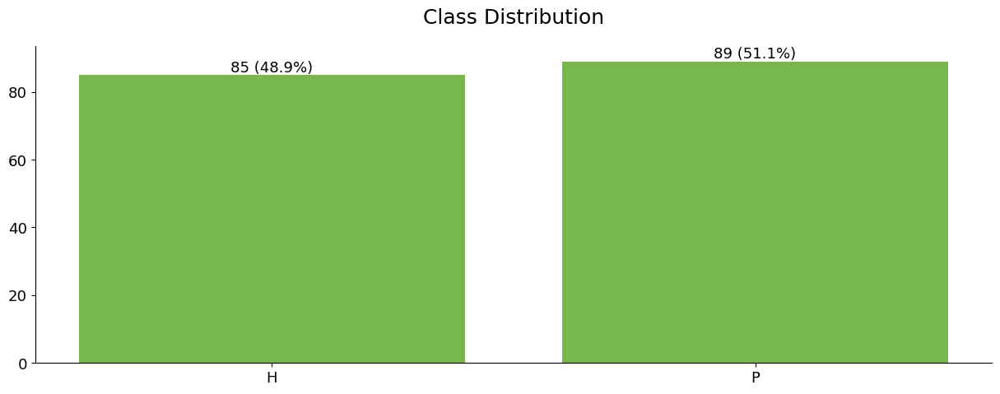

In [7]:
plt.figure(figsize=(15, 5))

data_analysis.class_dist(y, title="Class Distribution", colors=green_color, label_font_size=label_size)

plt.show()

In [8]:
numerical_columns_selector = selector(dtype_exclude=object)
categorical_columns_selector = selector(dtype_include=object)

numerical_columns = numerical_columns_selector(X)
categorical_columns = categorical_columns_selector(X)

In [9]:
from sklearn.compose import ColumnTransformer
print(f"Numerical Columns - {len(numerical_columns)}\n\n {numerical_columns}")
print(f"\n\n\nCategorical Columns - {len(categorical_columns)}\n\n {categorical_columns}")

Numerical Columns - 450

 ['air_time1', 'disp_index1', 'gmrt_in_air1', 'gmrt_on_paper1', 'max_x_extension1', 'max_y_extension1', 'mean_acc_in_air1', 'mean_acc_on_paper1', 'mean_gmrt1', 'mean_jerk_in_air1', 'mean_jerk_on_paper1', 'mean_speed_in_air1', 'mean_speed_on_paper1', 'num_of_pendown1', 'paper_time1', 'pressure_mean1', 'pressure_var1', 'total_time1', 'air_time2', 'disp_index2', 'gmrt_in_air2', 'gmrt_on_paper2', 'max_x_extension2', 'max_y_extension2', 'mean_acc_in_air2', 'mean_acc_on_paper2', 'mean_gmrt2', 'mean_jerk_in_air2', 'mean_jerk_on_paper2', 'mean_speed_in_air2', 'mean_speed_on_paper2', 'num_of_pendown2', 'paper_time2', 'pressure_mean2', 'pressure_var2', 'total_time2', 'air_time3', 'disp_index3', 'gmrt_in_air3', 'gmrt_on_paper3', 'max_x_extension3', 'max_y_extension3', 'mean_acc_in_air3', 'mean_acc_on_paper3', 'mean_gmrt3', 'mean_jerk_in_air3', 'mean_jerk_on_paper3', 'mean_speed_in_air3', 'mean_speed_on_paper3', 'num_of_pendown3', 'paper_time3', 'pressure_mean3', 'pressure

The only categorical column is 'ID' which has no relevance for classification because is just an identifier of each experiment, so it will be dropped

In [10]:
X = X.drop(columns=["ID"])
features_names = X.columns

In [11]:
# Convert from pandas to numpy and turn into a 1D array
y = y.to_numpy().ravel()
y = np.array([0 if x == 'H' else 1 for x in y])
y

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [12]:
sss_nsplits = 10
sss = StratifiedShuffleSplit(n_splits=sss_nsplits, test_size=0.2, random_state=42)

lr_clfs = []
lr_limes = []
lr_shaps = []
rf_clfs = []
rf_limes = []
rf_shaps = []
svm_clfs = []
svm_limes = []
svm_shaps = []
ebm_clfs = []

In [13]:
X_trains_pd = []
X_tests_pd = []
Y_trains = []
Y_tests = []

for i, (train_index, test_index) in enumerate(sss.split(X, y)):
    print(len(train_index), len(test_index))
    print(train_index, test_index)
    X_trains_pd.append(X.iloc[train_index])
    X_tests_pd.append(X.iloc[test_index])
    Y_trains.append(y[train_index])
    Y_tests.append(y[test_index])

139 35
[124 100 134 155  48  88  18  85 171 144  35  73   3 106 130 137  15  41
 170  94 146  37 111  97 150 132 119  54 164 161 166 120 154  98 127 107
  50  53  56  57  24  67  13  66  36 142  93  77 145 101  43  86  52  31
  95  19 156 153   5 115  99  96 102 123 133 128 125 116  20  51  39 114
 105  74  65  82  45 121  12 158   6 138  60  42   9  22  76 143 129  58
  81  78 117 108 122  46  49 172 169  83  16 173  30  92 139  25 131 167
  84  61  55  68 135   1  72  26  63  47  17 104  80  71  23  27  89 159
  21 136 151  33  38  69   2 147 165 113  11  29 157] [152  70 112 109  87 168 141  10   7  28  62  14 110  40  91  32  79  90
 149 163  34 140 162 126   4 103 118  44 160   8 148  64  75  59   0]
139 35
[ 69 164 109  64  20  44 160  76  59  23 159  81 140 171 153  88  52 108
  80 167  32 122 136 143  46 163  12  72 130  26  30 158 132  77 131  99
 127  92 161 114   4 124 152 162  36 151  14   1  78  10 150 172 116 100
 156  70 128  35 118  11 117   8 145 104   5   6 110  49 10

#### Instance to extract local explanations for all models

In [14]:
Exp_index = 3

# Classification

In [15]:
perf_analysis = PerformanceAnalysis()

## <i>Logistic Regression</i> (LR)

In [16]:
for i in range(sss_nsplits):
    lr_clf = LogisticRegression(solver="lbfgs", max_iter=500, C=0.01).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    lr_clfs.append(lr_clf)

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


### Extract Explanations

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [17]:
for i in range(sss_nsplits):
    lr_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    lr_limes.append(lr_LIME_explainer)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [18]:
shap.initjs()

In [19]:
for i in range(sss_nsplits):
    lr_SHAP_exp = shap.KernelExplainer(lr_clfs[i].predict_proba, shap.sample(X_trains_pd[i], 20))
    lr_shaps.append(lr_SHAP_exp)

## <i>Random Forest</i> (RF)

In [20]:
for i in range(sss_nsplits):
    rf_clf = RandomForestClassifier(n_estimators=100, bootstrap=False, max_features="log2").fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    rf_clfs.append(rf_clf)

### Extract Explanations 

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [21]:
for i in range(sss_nsplits):
    rf_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    rf_limes.append(rf_LIME_explainer)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [22]:
for i in range(sss_nsplits):
    rf_SHAP_exp = shap.Explainer(rf_clfs[i])
    rf_shaps.append(rf_SHAP_exp)

## <i> Support Vector Machines</i> (SVM)

In [23]:
for i in range(sss_nsplits):
    svm_clf = SVC(kernel="rbf", C=500, decision_function_shape="ovr", gamma="scale", probability=True).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    svm_clfs.append(svm_clf)

### Extract Explanations

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [24]:
for i in range(sss_nsplits):
    svm_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    svm_limes.append(svm_LIME_explainer)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [25]:
for i in range(sss_nsplits):
    svm_SHAP_exp = shap.KernelExplainer(svm_clfs[i].predict_proba, shap.sample(X_trains_pd[i], 20))
    svm_shaps.append(svm_SHAP_exp)

## <i>Explainable Boosting Machine</i> (EBM)

In [26]:
for i in range(sss_nsplits):
    ebm_clf = ExplainableBoostingClassifier(max_bins=1024, smoothing_rounds=500, cyclic_progress=0).fit(X_trains_pd[i], Y_trains[i])
    ebm_clfs.append(ebm_clf)

# Summary

In [27]:
visual = Visualization()

## Metrics

In [28]:
lr_cms = []
rf_cms = []
svm_cms = []
ebm_cms = []

lr_metrics_lst = []
rf_metrics_lst = []
svm_metrics_lst = []
ebm_metrics_lst = []

for i in range(sss_nsplits):
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    lr_cm = confusion_matrix(Y_tests[i], lr_ye)
    
    lr_metrics = perf_analysis.compute_metrics(lr_cm)
    lr_metrics = lr_metrics.rename(columns={"Values": "LR"})
    lr_metrics["LR"] = [round(x, 2) for x in lr_metrics["LR"]]
    lr_metrics_lst.append(lr_metrics)
    lr_cms.append(lr_cm)
    
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_cm = confusion_matrix(Y_tests[i], rf_ye)
    rf_metrics = perf_analysis.compute_metrics(rf_cm)
    rf_metrics = rf_metrics.rename(columns={"Values": "RF"})
    rf_metrics["RF"] = [round(x, 2) for x in rf_metrics["RF"]]
    rf_metrics_lst.append(rf_metrics)
    rf_cms.append(rf_cm)

    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_cm = confusion_matrix(Y_tests[i], svm_ye)
    svm_metrics = perf_analysis.compute_metrics(svm_cm)
    svm_metrics = svm_metrics.rename(columns={"Values": "SVM"})
    svm_metrics["SVM"] = [round(x, 2) for x in svm_metrics["SVM"]]
    svm_metrics_lst.append(svm_metrics)
    svm_cms.append(svm_cm)

    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_cm = confusion_matrix(Y_tests[i], ebm_ye)
    ebm_metrics = perf_analysis.compute_metrics(ebm_cm)
    ebm_metrics = ebm_metrics.rename(columns={"Values": "EBM"})
    ebm_metrics["EBM"] = [round(x, 2) for x in ebm_metrics["EBM"]]
    ebm_metrics_lst.append(ebm_metrics)
    ebm_cms.append(ebm_cm)

    overall_metrics = pd.concat([lr_metrics, rf_metrics, svm_metrics, ebm_metrics], axis=1)
    display(overall_metrics)

Metrics,LR,RF,SVM,EBM
accuracy,0.66,0.83,0.71,0.83
false-positive rate,0.41,0.24,0.29,0.18
false-negative rate,0.28,0.11,0.28,0.17
precision,0.65,0.80,0.72,0.83
recall,0.72,0.89,0.72,0.83
f-score,0.68,0.84,0.72,0.83


Metrics,LR,RF,SVM,EBM
accuracy,0.80,0.91,0.80,0.97
false-positive rate,0.18,0.12,0.24,0.06
false-negative rate,0.22,0.06,0.17,0.00
precision,0.82,0.89,0.79,0.95
recall,0.78,0.94,0.83,1.00
f-score,0.80,0.92,0.81,0.97


Metrics,LR,RF,SVM,EBM
accuracy,0.89,1.0,0.83,1.0
false-positive rate,0.12,0.0,0.12,0.0
false-negative rate,0.11,0.0,0.22,0.0
precision,0.89,1.0,0.88,1.0
recall,0.89,1.0,0.78,1.0
f-score,0.89,1.0,0.82,1.0


Metrics,LR,RF,SVM,EBM
accuracy,0.83,0.91,0.86,0.89
false-positive rate,0.18,0.12,0.29,0.12
false-negative rate,0.17,0.06,0.00,0.11
precision,0.83,0.89,0.78,0.89
recall,0.83,0.94,1.00,0.89
f-score,0.83,0.92,0.88,0.89


Metrics,LR,RF,SVM,EBM
accuracy,0.86,0.91,0.83,0.86
false-positive rate,0.18,0.12,0.18,0.12
false-negative rate,0.11,0.06,0.17,0.17
precision,0.84,0.89,0.83,0.88
recall,0.89,0.94,0.83,0.83
f-score,0.86,0.92,0.83,0.86


Metrics,LR,RF,SVM,EBM
accuracy,0.77,0.74,0.74,0.86
false-positive rate,0.12,0.24,0.18,0.06
false-negative rate,0.33,0.28,0.33,0.22
precision,0.86,0.76,0.80,0.93
recall,0.67,0.72,0.67,0.78
f-score,0.75,0.74,0.73,0.85


Metrics,LR,RF,SVM,EBM
accuracy,0.83,0.91,0.86,0.86
false-positive rate,0.18,0.12,0.12,0.12
false-negative rate,0.17,0.06,0.17,0.17
precision,0.83,0.89,0.88,0.88
recall,0.83,0.94,0.83,0.83
f-score,0.83,0.92,0.86,0.86


Metrics,LR,RF,SVM,EBM
accuracy,0.74,0.86,0.74,0.83
false-positive rate,0.06,0.06,0.06,0.06
false-negative rate,0.44,0.22,0.44,0.28
precision,0.91,0.93,0.91,0.93
recall,0.56,0.78,0.56,0.72
f-score,0.69,0.85,0.69,0.81


Metrics,LR,RF,SVM,EBM
accuracy,0.83,0.91,0.80,0.91
false-positive rate,0.24,0.06,0.24,0.06
false-negative rate,0.11,0.11,0.17,0.11
precision,0.80,0.94,0.79,0.94
recall,0.89,0.89,0.83,0.89
f-score,0.84,0.91,0.81,0.91


Metrics,LR,RF,SVM,EBM
accuracy,0.69,0.80,0.69,0.89
false-positive rate,0.18,0.24,0.18,0.06
false-negative rate,0.44,0.17,0.44,0.17
precision,0.77,0.79,0.77,0.94
recall,0.56,0.83,0.56,0.83
f-score,0.65,0.81,0.65,0.88


In [29]:
lr_metrics_concat = pd.concat(tuple(lr_metrics_lst[:]), axis=1)
lr_means = lr_metrics_concat.mean(axis=1).to_frame()
lr_means = lr_means.rename(columns={0: "LR"})
lr_means["LR"] = [round(x, 2) for x in lr_means["LR"]]

In [30]:
lr_std = lr_metrics_concat.std(axis=1).to_frame()
lr_std = lr_std.rename(columns={0: "LR"})
lr_std["LR"] = [round(x, 2) for x in lr_std["LR"]]

In [31]:
rf_metrics_concat = pd.concat(tuple(rf_metrics_lst[:]), axis=1)
rf_means = rf_metrics_concat.mean(axis=1).to_frame()
rf_means = rf_means.rename(columns={0: "RF"})
rf_means["RF"] = [round(x, 2) for x in rf_means["RF"]]

In [32]:
rf_std = rf_metrics_concat.std(axis=1).to_frame()
rf_std = rf_std.rename(columns={0: "RF"})
rf_std["RF"] = [round(x, 2) for x in rf_std["RF"]]

In [33]:
svm_metrics_concat = pd.concat(tuple(svm_metrics_lst[:]), axis=1)
svm_means = svm_metrics_concat.mean(axis=1).to_frame()
svm_means = svm_means.rename(columns={0: "SVM"})
svm_means["SVM"] = [round(x, 2) for x in svm_means["SVM"]]

In [34]:
svm_std = svm_metrics_concat.std(axis=1).to_frame()
svm_std = svm_std.rename(columns={0: "SVM"})
svm_std["SVM"] = [round(x, 2) for x in svm_std["SVM"]]

In [35]:
ebm_metrics_concat = pd.concat(tuple(ebm_metrics_lst[:]), axis=1)
ebm_means = ebm_metrics_concat.mean(axis=1).to_frame()
ebm_means = ebm_means.rename(columns={0: "EBM"})
ebm_means["EBM"] = [round(x, 2) for x in ebm_means["EBM"]]

In [36]:
ebm_std = ebm_metrics_concat.std(axis=1).to_frame()
ebm_std = ebm_std.rename(columns={0: "EBM"})
ebm_std["EBM"] = [round(x, 2) for x in ebm_std["EBM"]]

### Mean of obtained metrics

In [37]:
overall_metrics_means = pd.concat([lr_means, rf_means, svm_means, ebm_means], axis=1)
display(overall_metrics_means)

,LR,RF,SVM,EBM
accuracy,0.79,0.88,0.79,0.89
false-positive rate,0.18,0.13,0.19,0.08
false-negative rate,0.24,0.11,0.24,0.14
precision,0.82,0.88,0.82,0.92
recall,0.76,0.89,0.76,0.86
f-score,0.78,0.88,0.78,0.89


### Standard Deviation of obtained metrics

In [38]:
overall_metrics_std = pd.concat([lr_std, rf_std, svm_std, ebm_std], axis=1)
display(overall_metrics_std)

,LR,RF,SVM,EBM
accuracy,0.07,0.07,0.06,0.06
false-positive rate,0.09,0.08,0.08,0.05
false-negative rate,0.13,0.09,0.14,0.09
precision,0.07,0.07,0.06,0.05
recall,0.13,0.09,0.14,0.09
f-score,0.08,0.07,0.08,0.06


#### Save means in disk

In [39]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_means.columns]) + " \\\ \n"

In [40]:
for i, row in overall_metrics_means.iterrows():
    
    aux_str = i
    for k in row:
        aux_str += f" & {k}"
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/darwin_metrics_means.txt", "w") as text_file:
    print(latex_str, file=text_file)

#### Save standard deviations in disk

In [41]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_std.columns]) + " \\\ \n"

In [42]:
for i, row in overall_metrics_std.iterrows():
    
    aux_str = i
    for k in row:
        aux_str += f" & {k}"
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/darwin_metrics_std.txt", "w") as text_file:
    print(latex_str, file=text_file)

#### Save means with std in disk

In [43]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_means.columns]) + " \\\ \n"

In [44]:
for i, row in overall_metrics_means.iterrows():
    
    aux_str = i
    
    cont = 0
    for k in row:
        aux_str += f" & {k} \\textpm{overall_metrics_std.loc[[i]].iloc[0].iloc[cont]}"
        cont += 1
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/darwin_metrics_means_wstd.txt", "w") as text_file:
    print(latex_str, file=text_file)

## Confusion Matrices

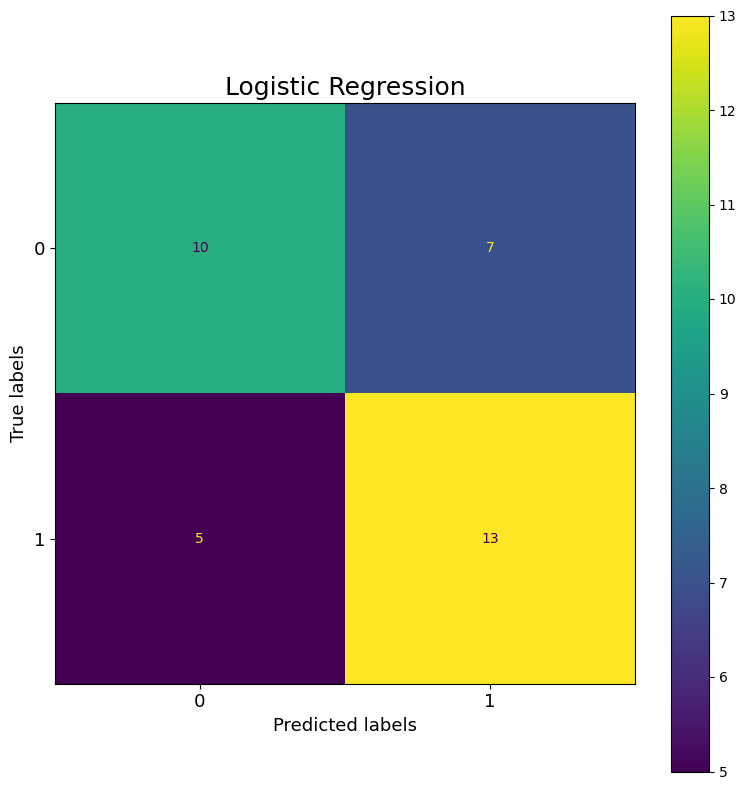

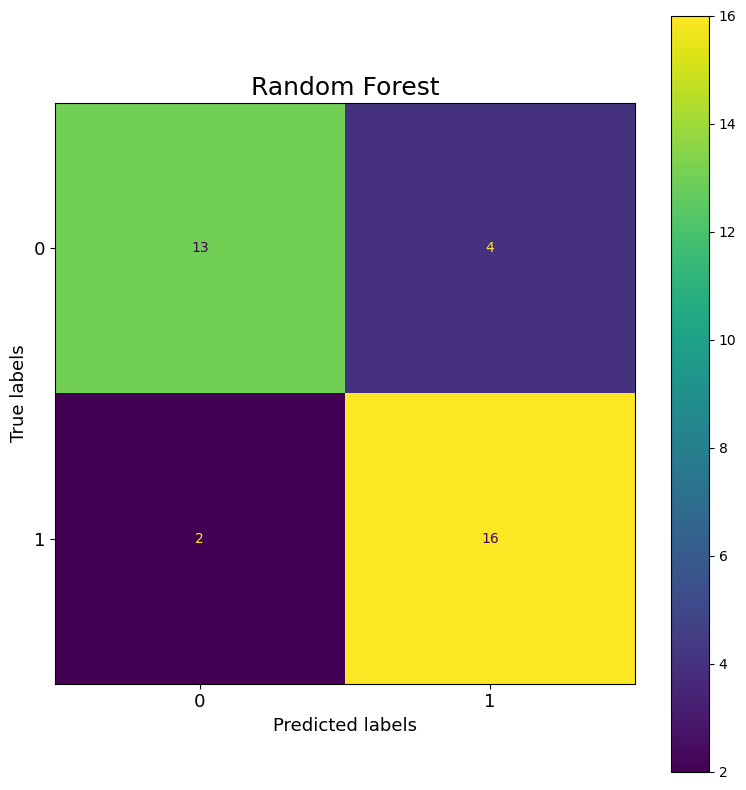

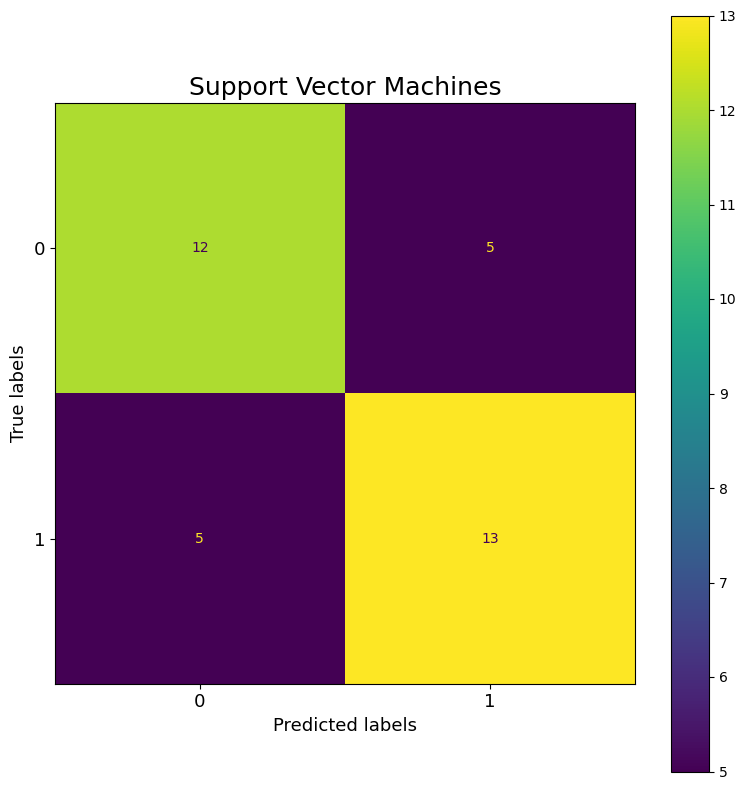

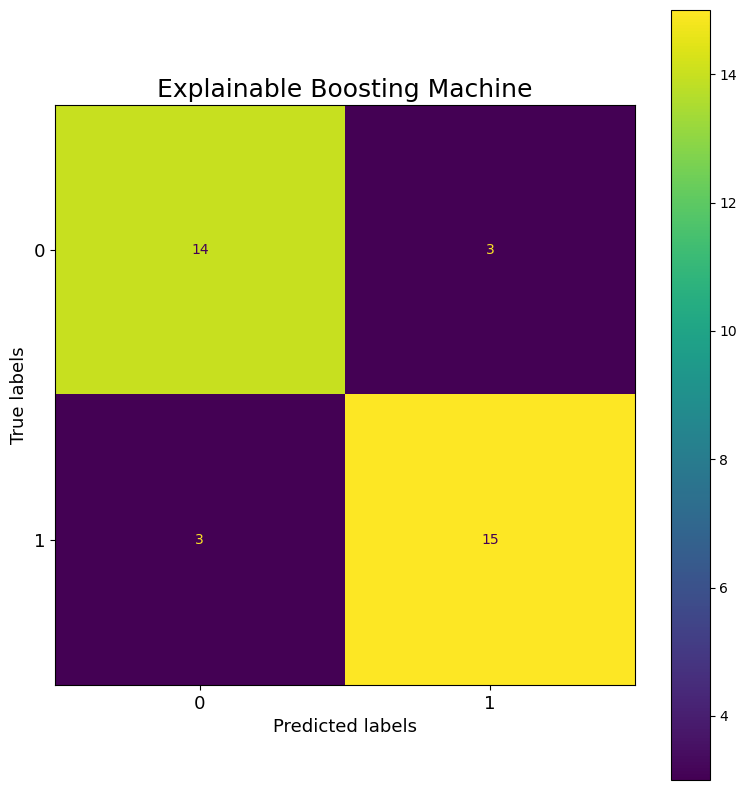

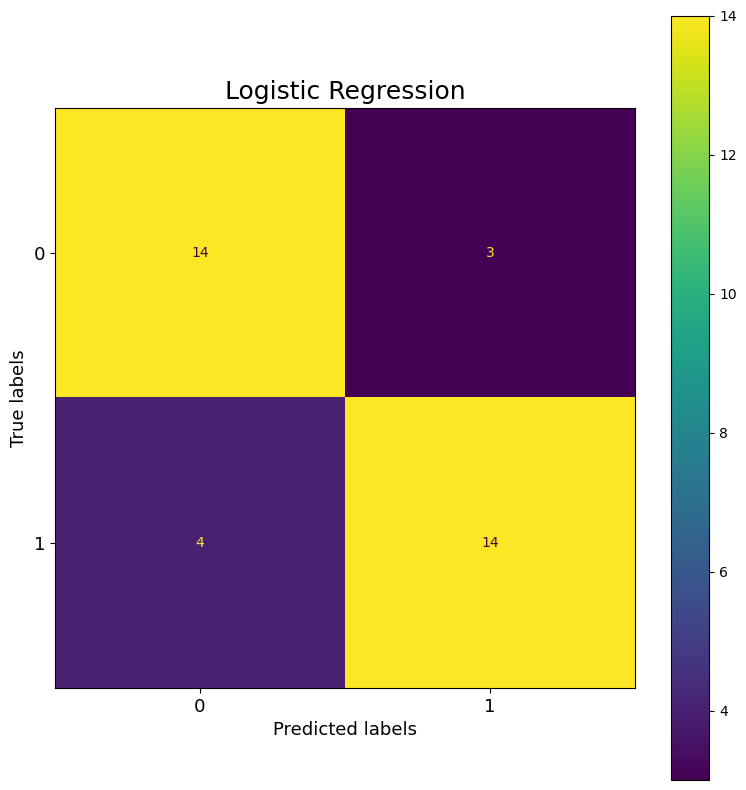

...

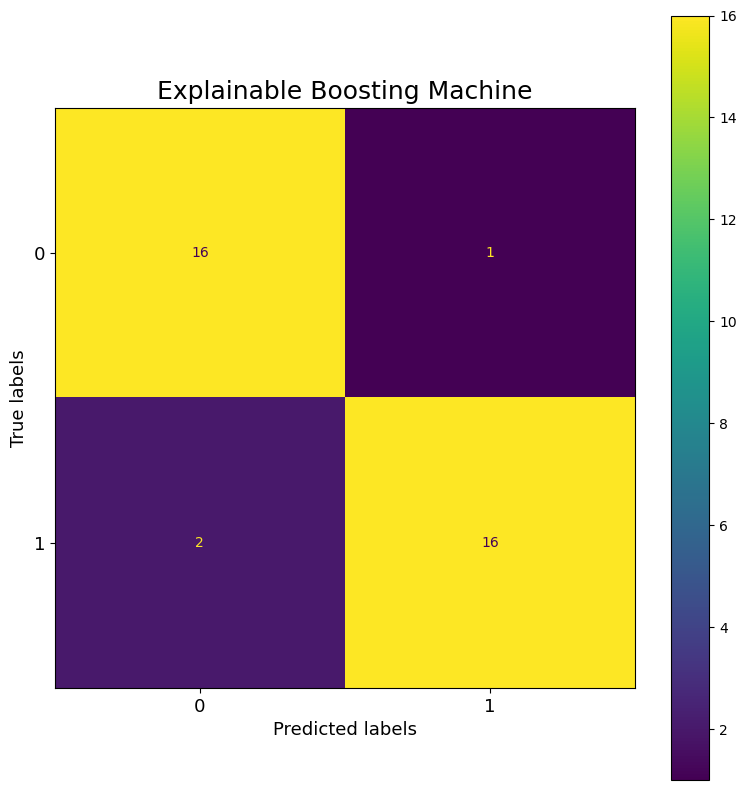

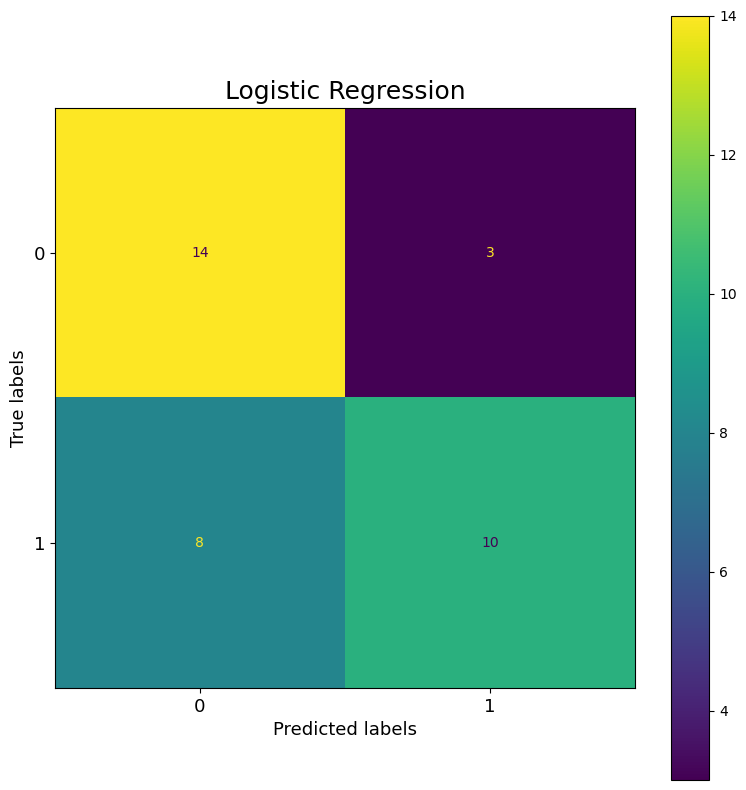

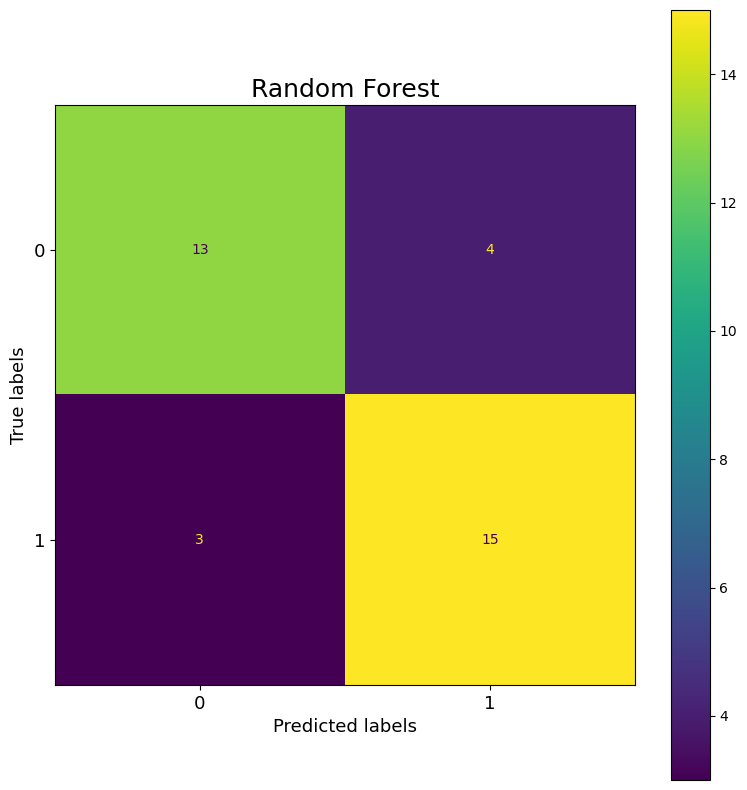

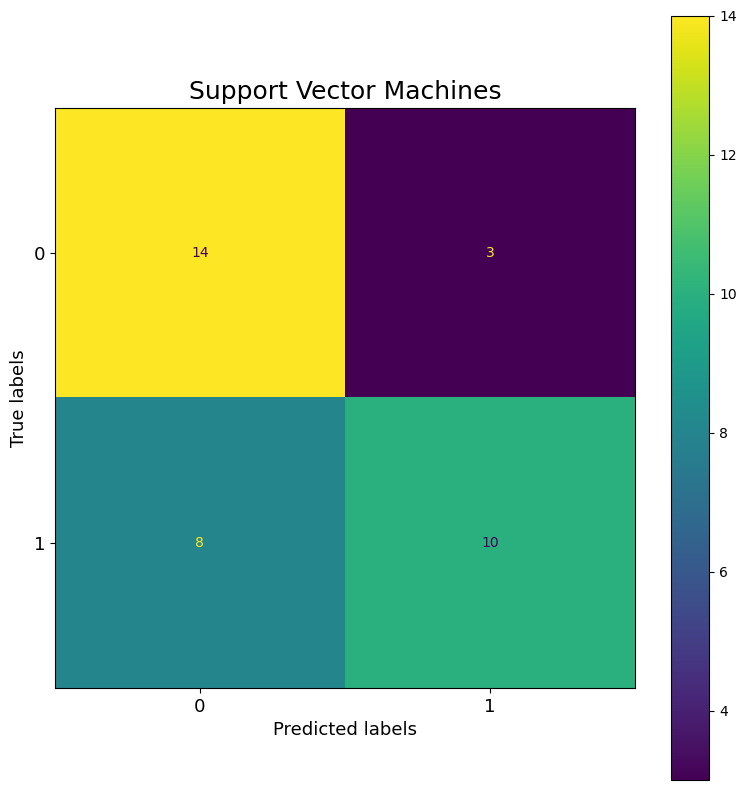

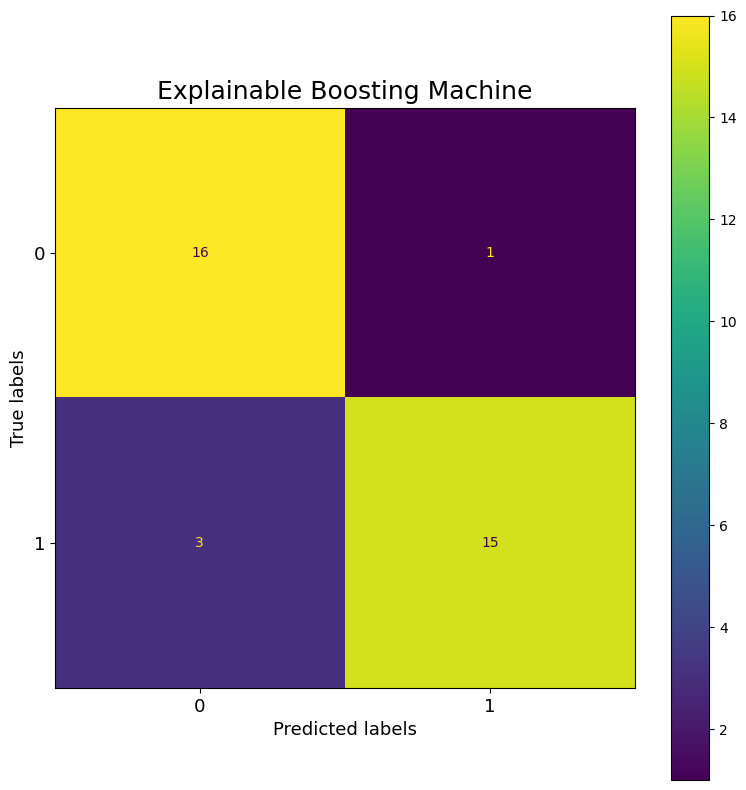

In [45]:
for i in range(sss_nsplits):
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    visual.confusion_matrices_pred([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], 
                              [lr_ye, rf_ye, svm_ye, ebm_ye],
                              nrows=2, 
                              ncols=2, 
                              figsize=(8, 8),
                              title_size=title_size,
                              label_size=label_size,
                              titles=["Logistic Regression", "Random Forest", "Support Vector Machines", "Explainable Boosting Machine"],
                              save_name=f"{logs_dir}/darwin_conf_matrices_{i}"
                              )
    
    # plt.savefig(f"{logs_dir}/darwin_conf_matrices_95.png", bbox_inches="tight")
    
    plt.show()

## Curves

[[10  7]
 [ 5 13]]


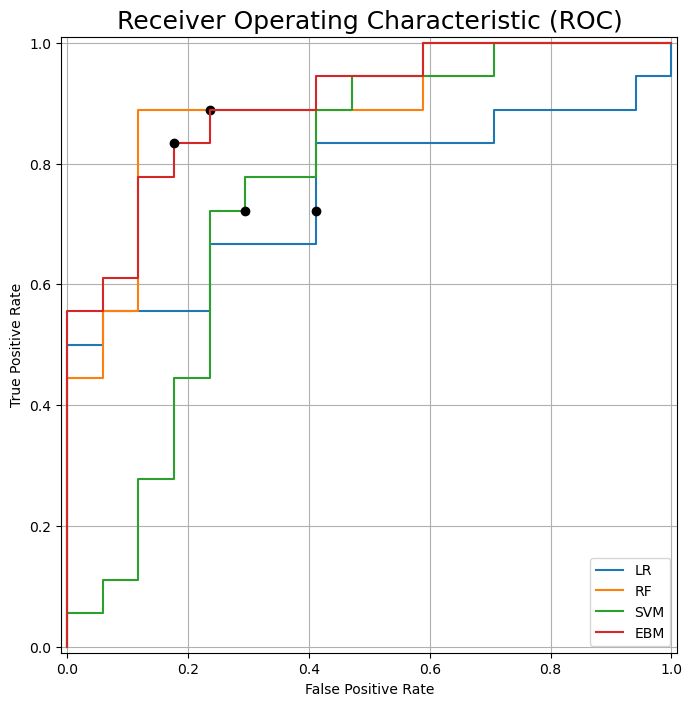

[[14  3]
 [ 4 14]]


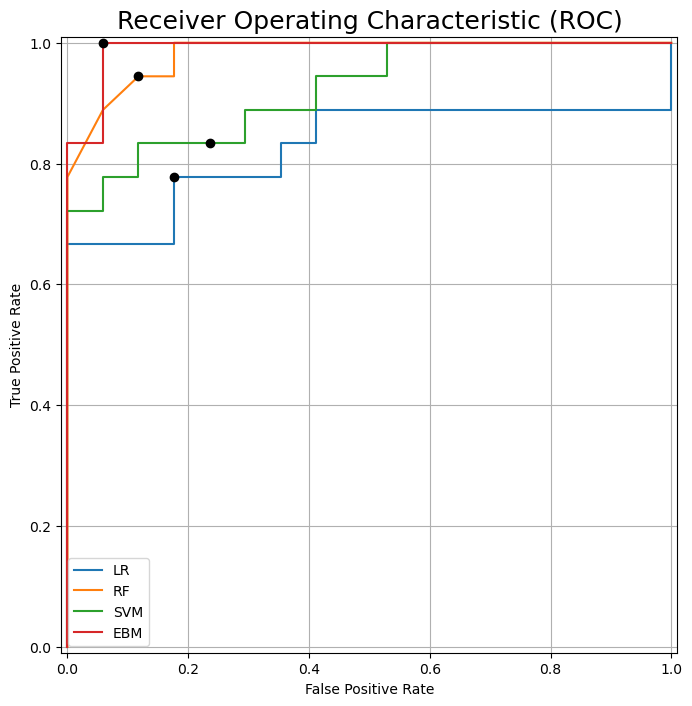

[[15  2]
 [ 2 16]]


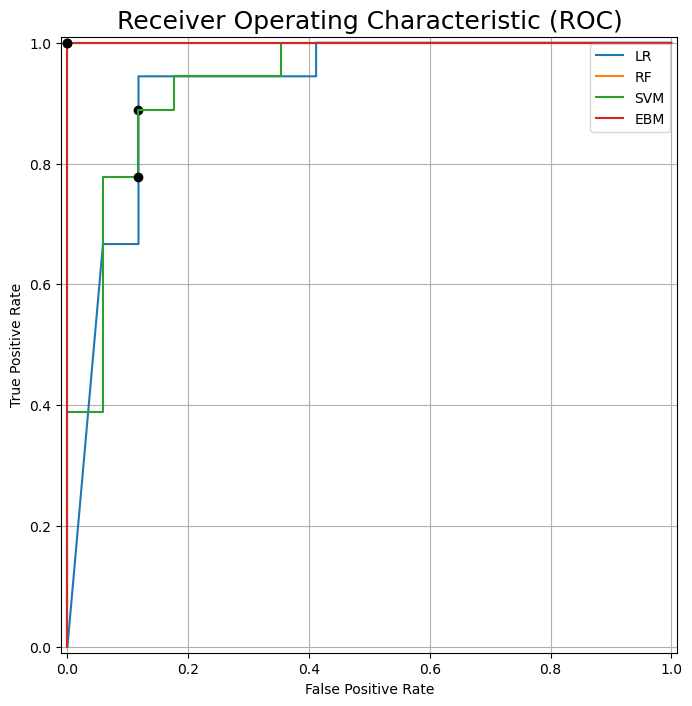

[[14  3]
 [ 3 15]]


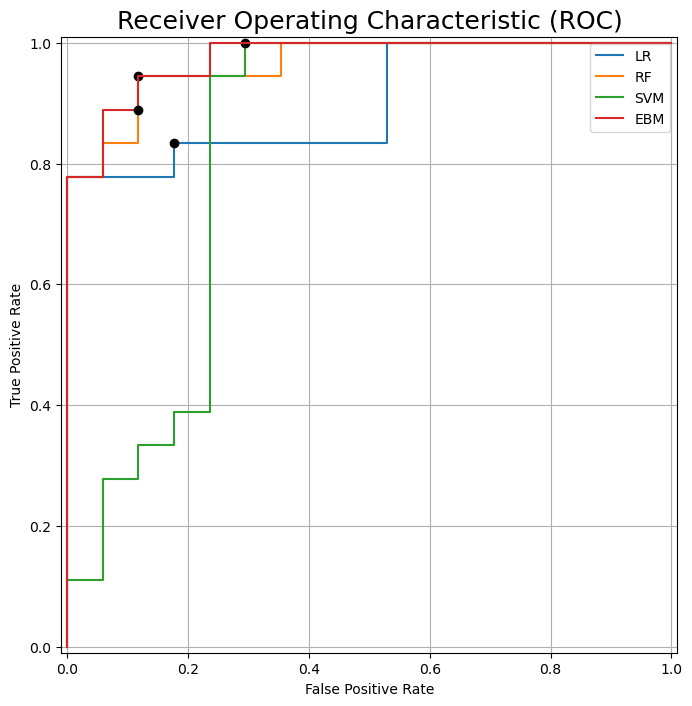

[[14  3]
 [ 2 16]]


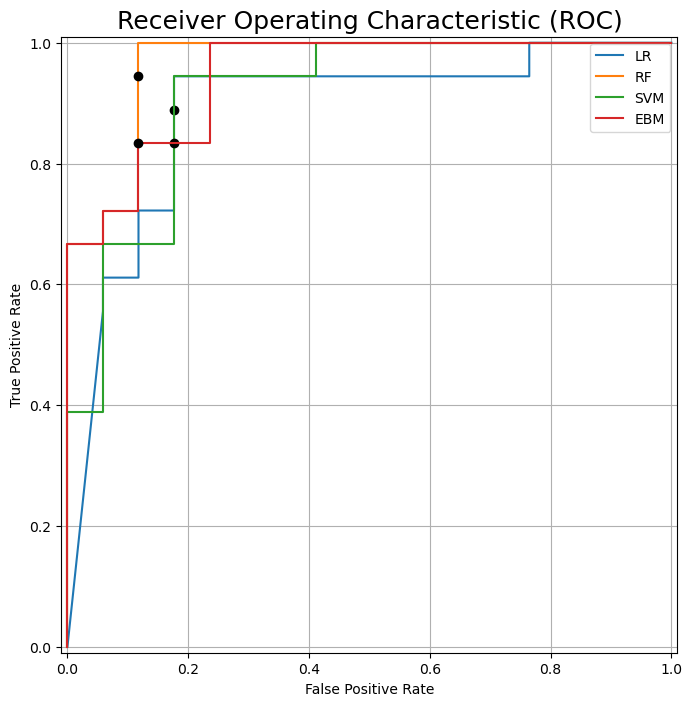

[[15  2]
 [ 6 12]]


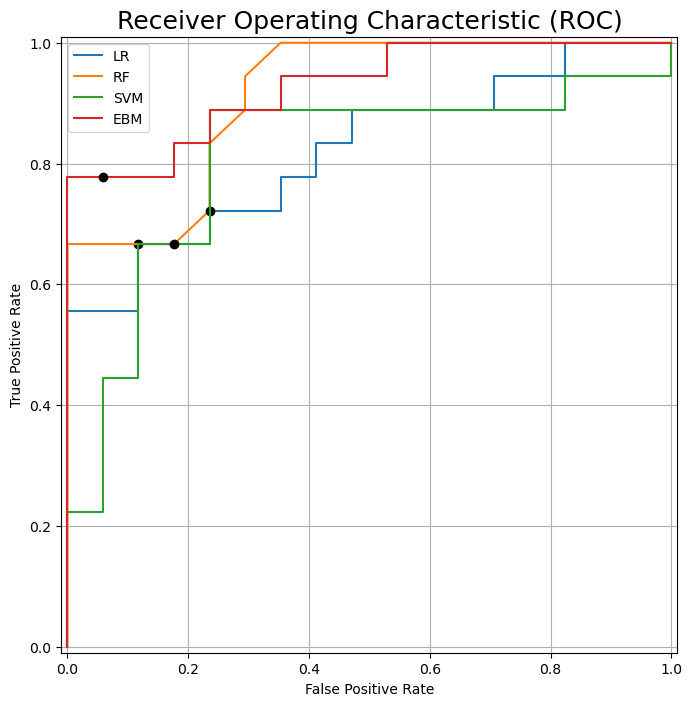

[[14  3]
 [ 3 15]]


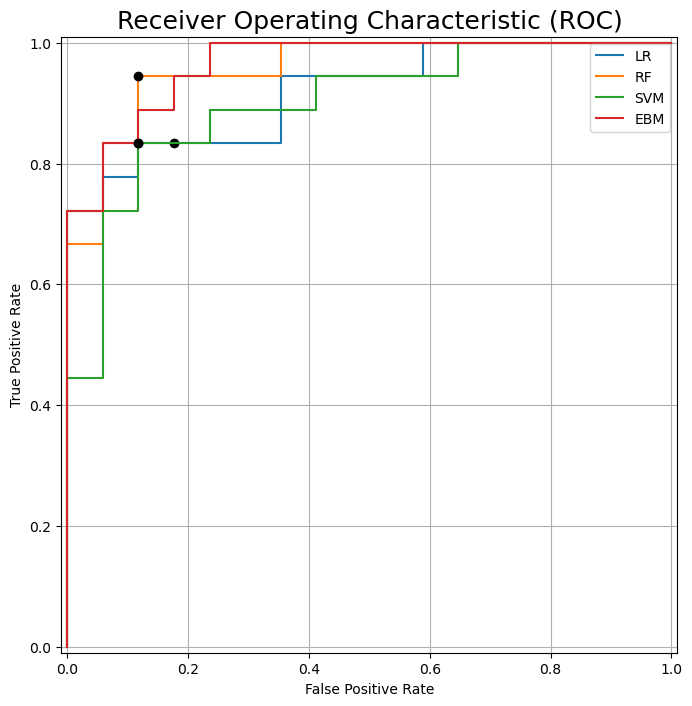

[[16  1]
 [ 8 10]]


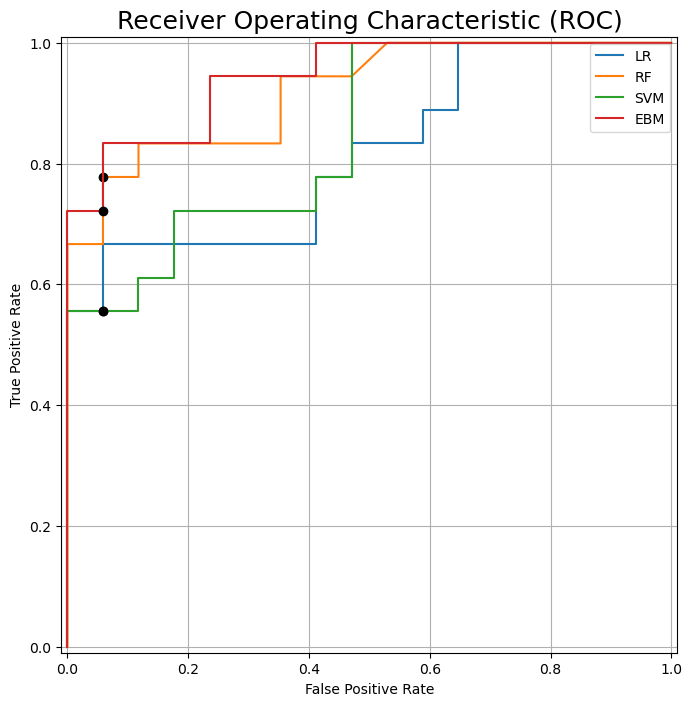

[[13  4]
 [ 2 16]]


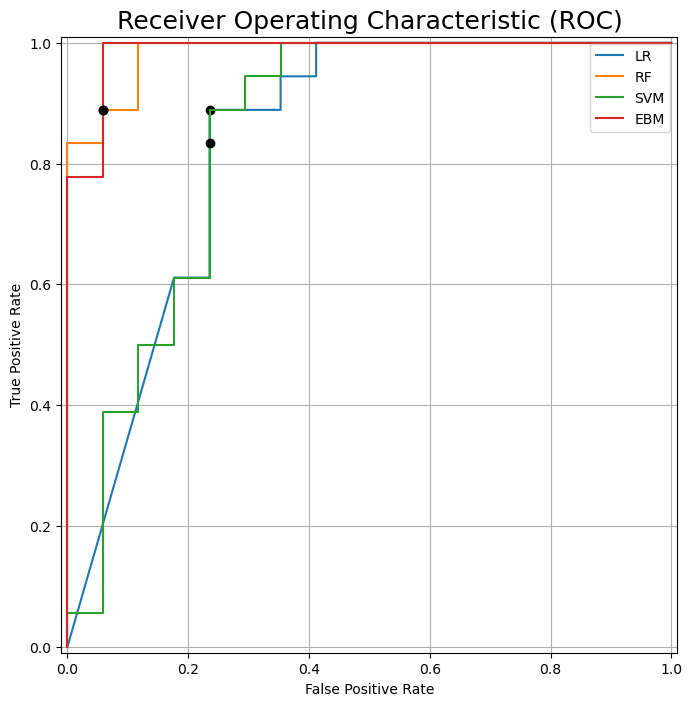

[[14  3]
 [ 8 10]]


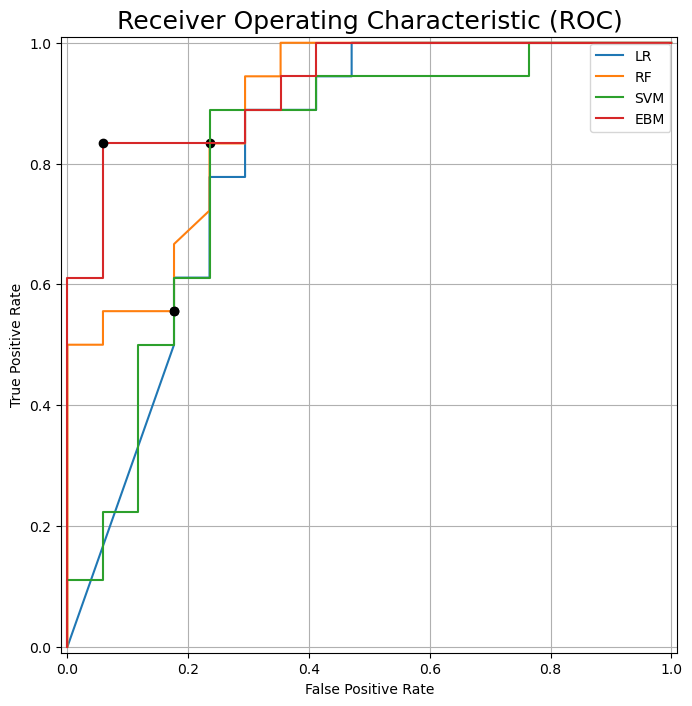

In [46]:
for i in range(sss_nsplits):
    plt.figure(figsize=(8, 8))
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    
    lr_cm = lr_cms[i]
    rf_cm = rf_cms[i]
    svm_cm = svm_cms[i]
    ebm_cm = ebm_cms[i]
    
    print(lr_cm)
    
    lr_y2d = lr_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    rf_y2d = rf_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    svm_y2d = svm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    ebm_y2d = ebm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    
    perf_analysis.compare_ROC([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], [lr_cm, rf_cm, svm_cm, ebm_cm], [lr_y2d, rf_y2d, svm_y2d, ebm_y2d], ["LR","RF", "SVM", "EBM"])
    
    plt.savefig(f"{logs_dir}/darwin_ROC_{i}.png", bbox_inches="tight")
    
    plt.show()

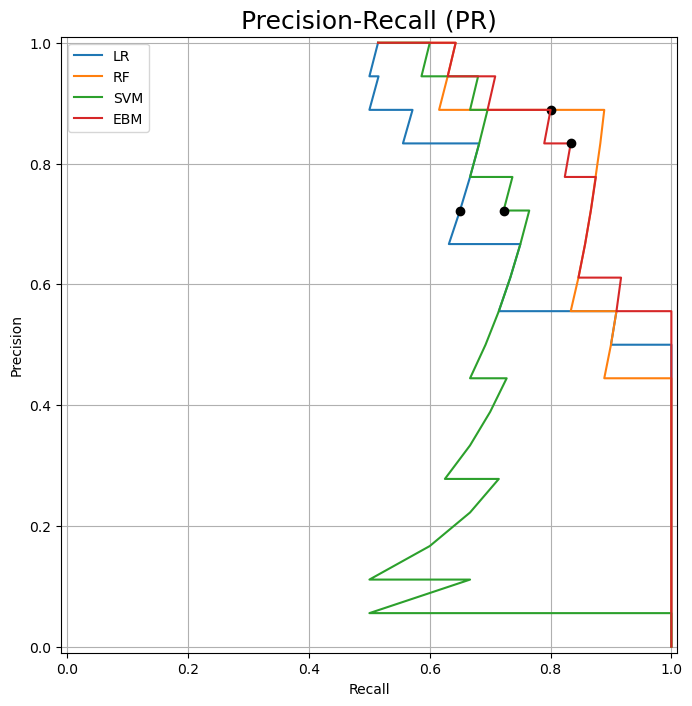

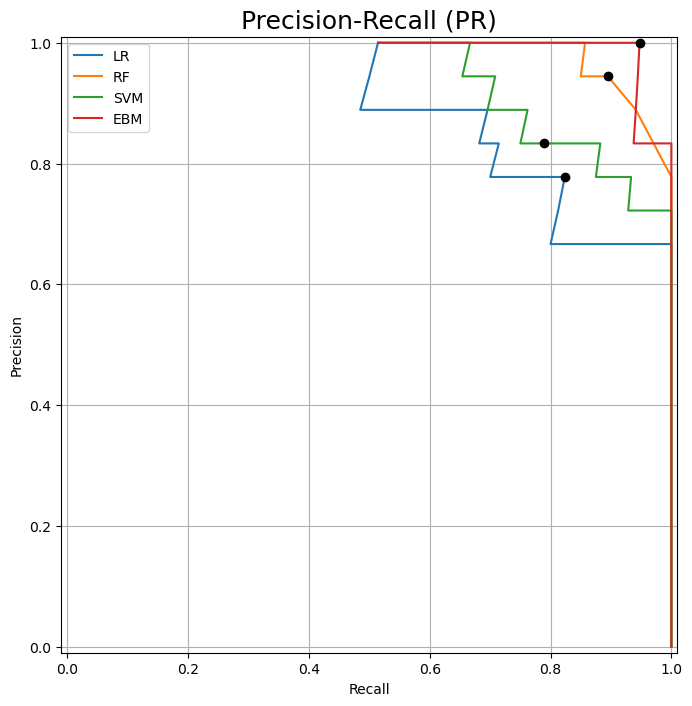

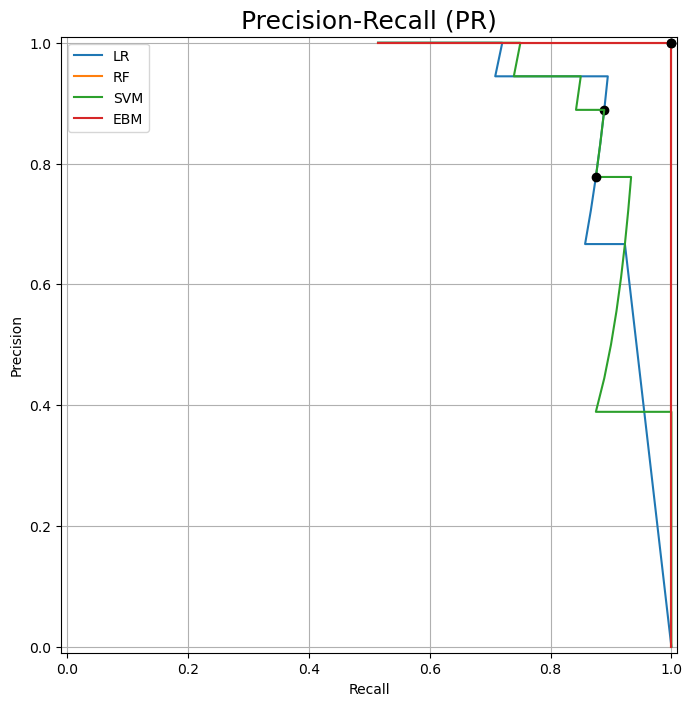

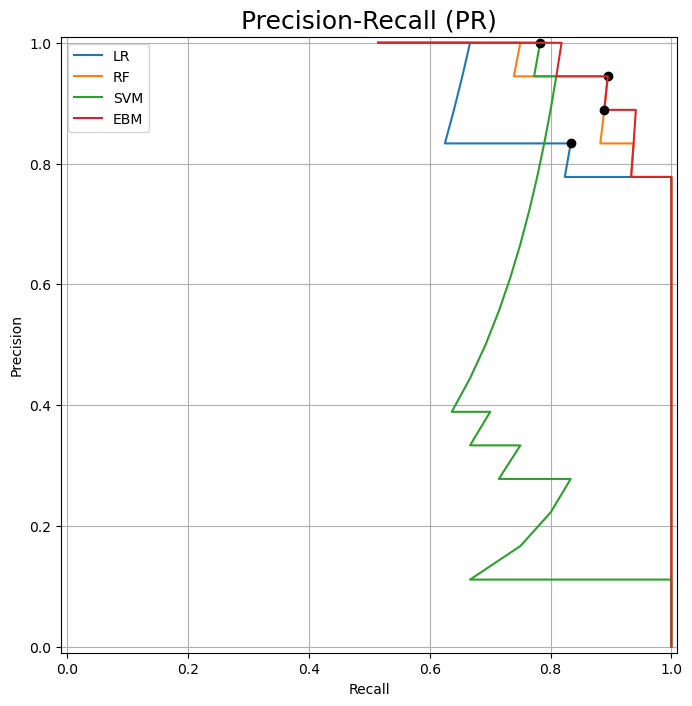

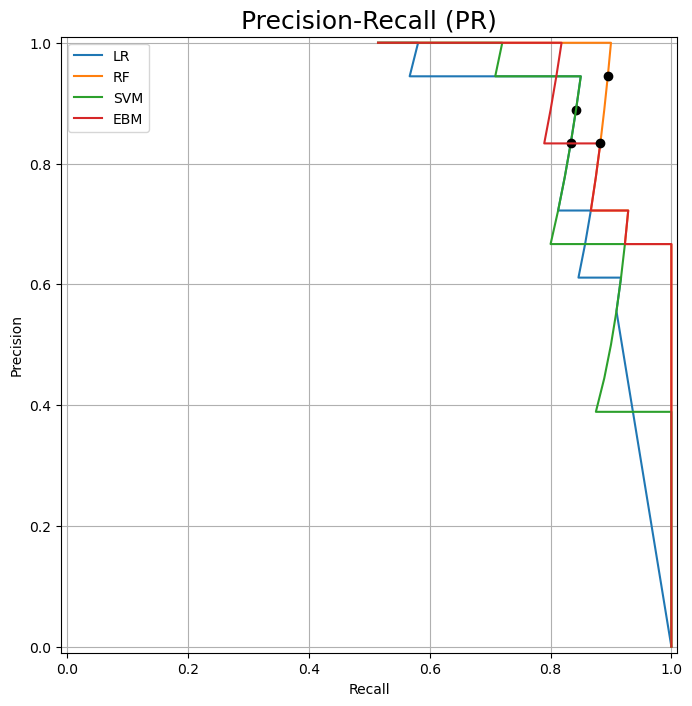

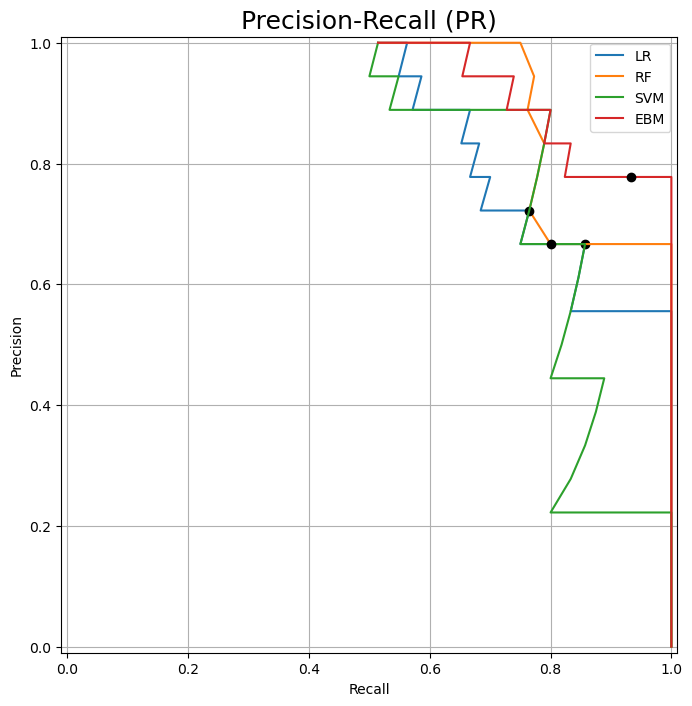

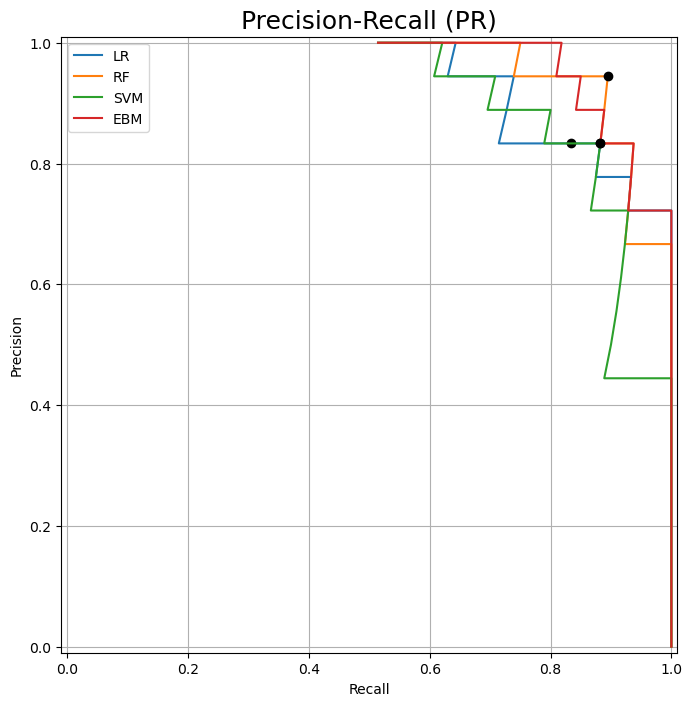

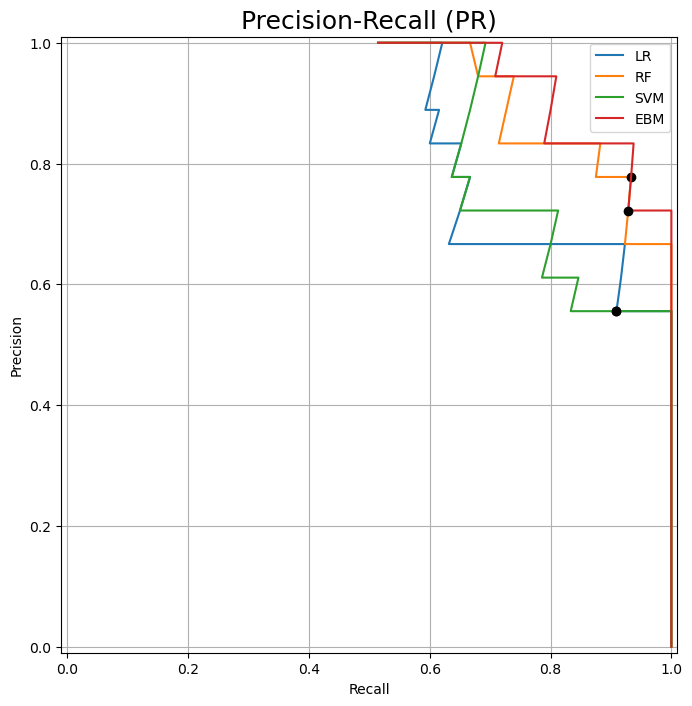

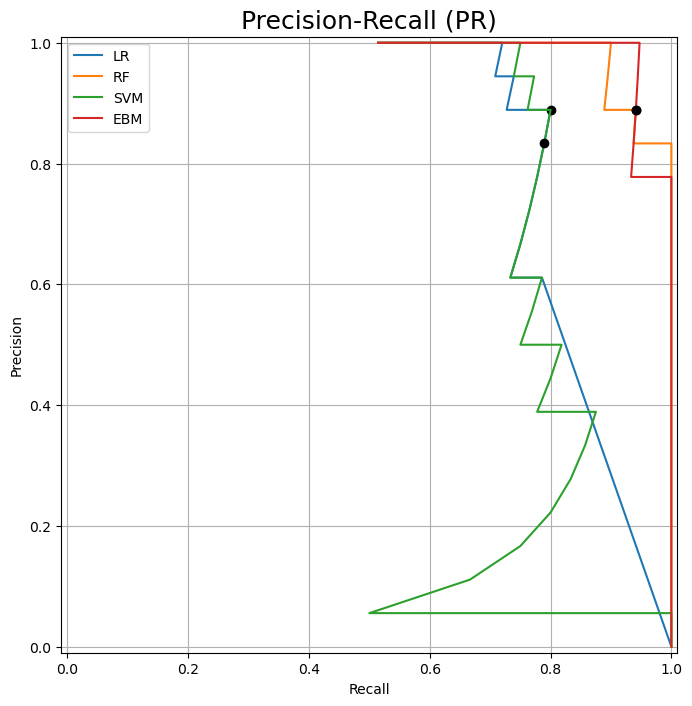

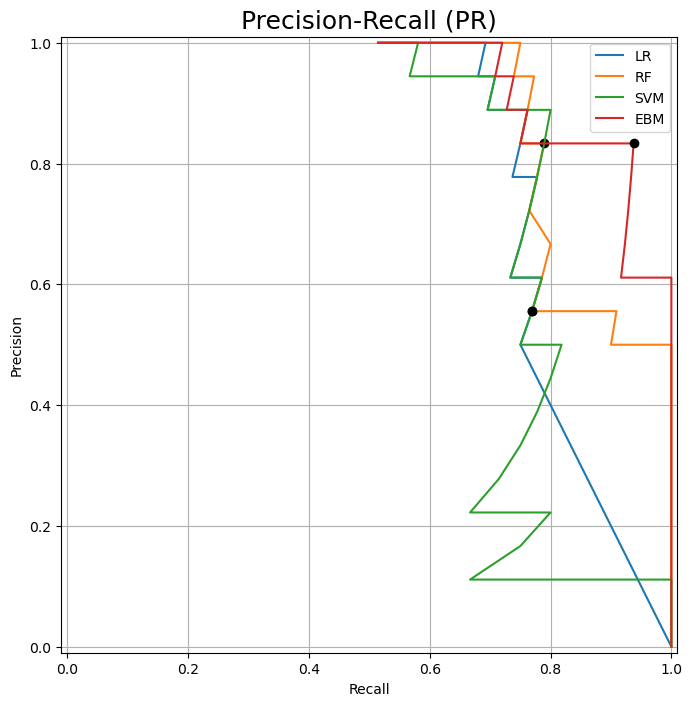

In [47]:
for i in range(sss_nsplits):
    plt.figure(figsize=(8, 8))
    
    lr_cm = lr_cms[i]
    rf_cm = rf_cms[i]
    svm_cm = svm_cms[i]
    ebm_cm = ebm_cms[i]
    
    lr_y2d = lr_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    rf_y2d = rf_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    svm_y2d = svm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    ebm_y2d = ebm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    
    perf_analysis.compare_PR([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], [lr_cm, rf_cm, svm_cm, ebm_cm], [lr_y2d, rf_y2d, svm_y2d, ebm_y2d], ["LR","RF", "SVM", "EBM"])
    
    plt.savefig(f"{logs_dir}/darwin_PR_{i}.png", bbox_inches="tight")
    
    plt.show()

## Local Explanations

### LIME

In [48]:
for i in range(sss_nsplits):
    lr_LIME_explanation = lr_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], lr_clfs[i].predict_proba)
    lr_LIME_explanation.show_in_notebook(show_table=True)
    lr_LIME_explanation.save_to_file(f"{logs_dir}/darwin_LR_LIME_{i}.html")

In [49]:
for i in range(sss_nsplits):
    rf_LIME_explanation = rf_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], rf_clfs[i].predict_proba)
    rf_LIME_explanation.show_in_notebook(show_table=True)
    rf_LIME_explanation.save_to_file(f"{logs_dir}/darwin_RF_LIME_{i}.html")

In [50]:
for i in range(sss_nsplits):
    svm_LIME_explanation = svm_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], svm_clfs[i].predict_proba)
    svm_LIME_explanation.show_in_notebook(show_table=True)
    svm_LIME_explanation.save_to_file(f"{logs_dir}/darwin_SVM_LIME_{i}.html")

### SHAP & EBM

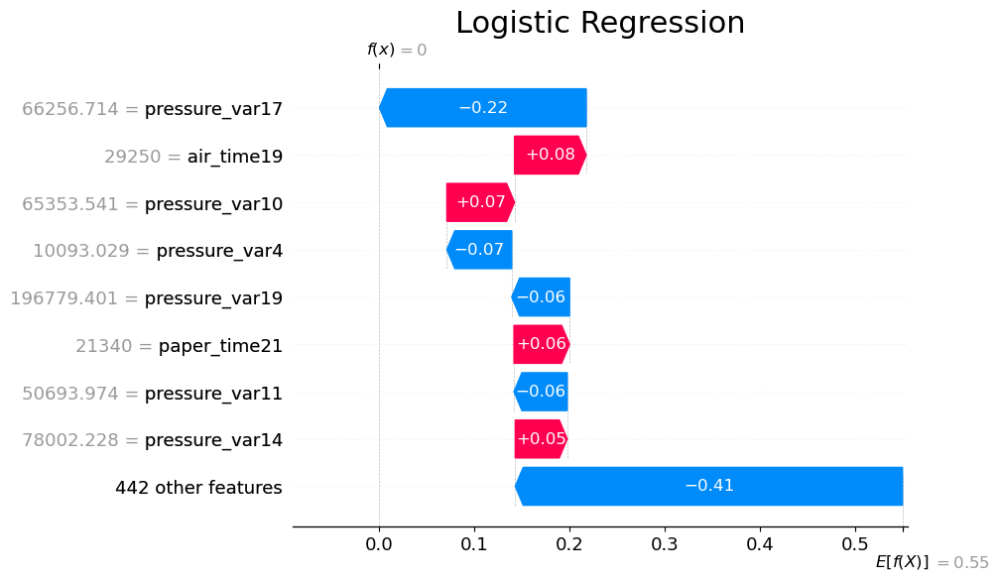

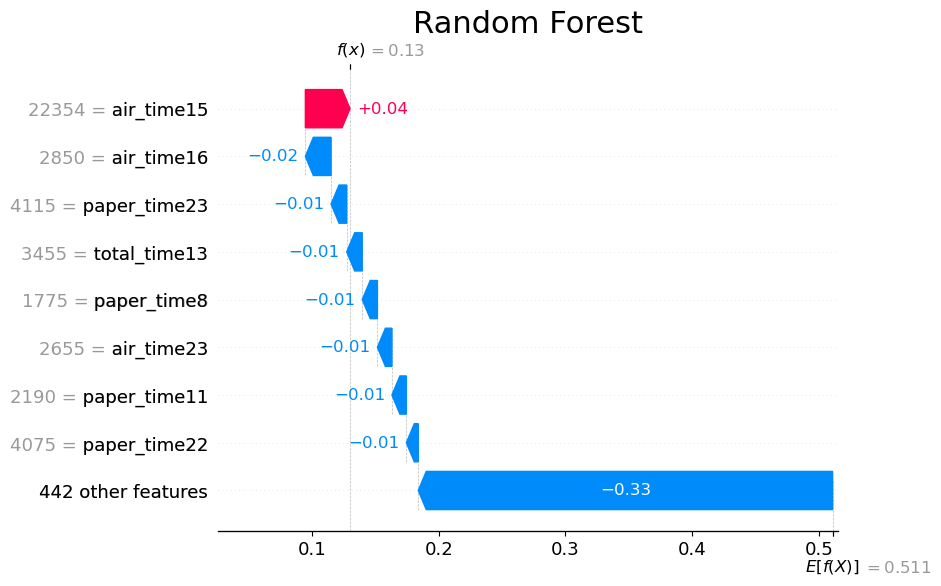

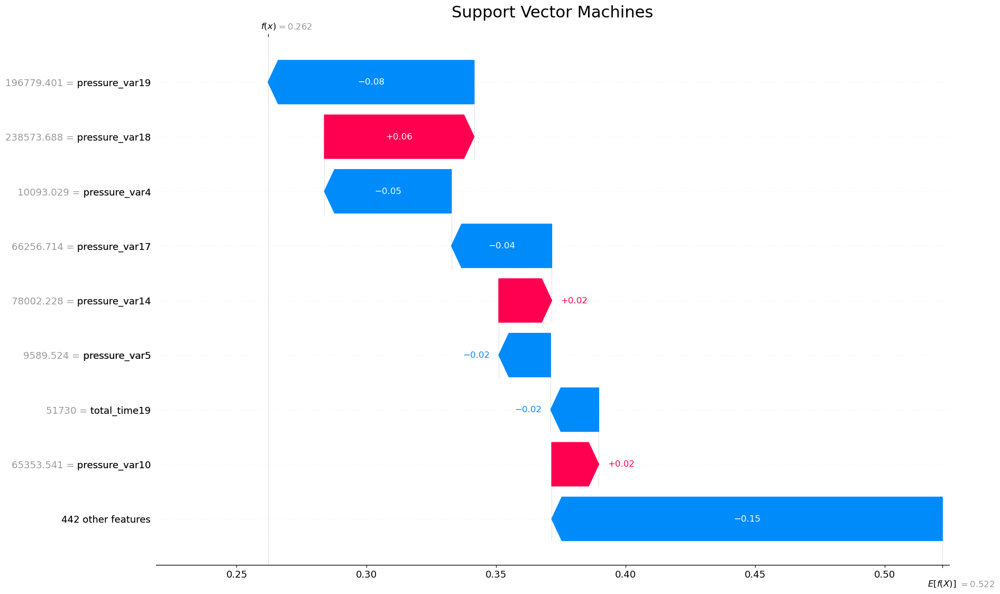

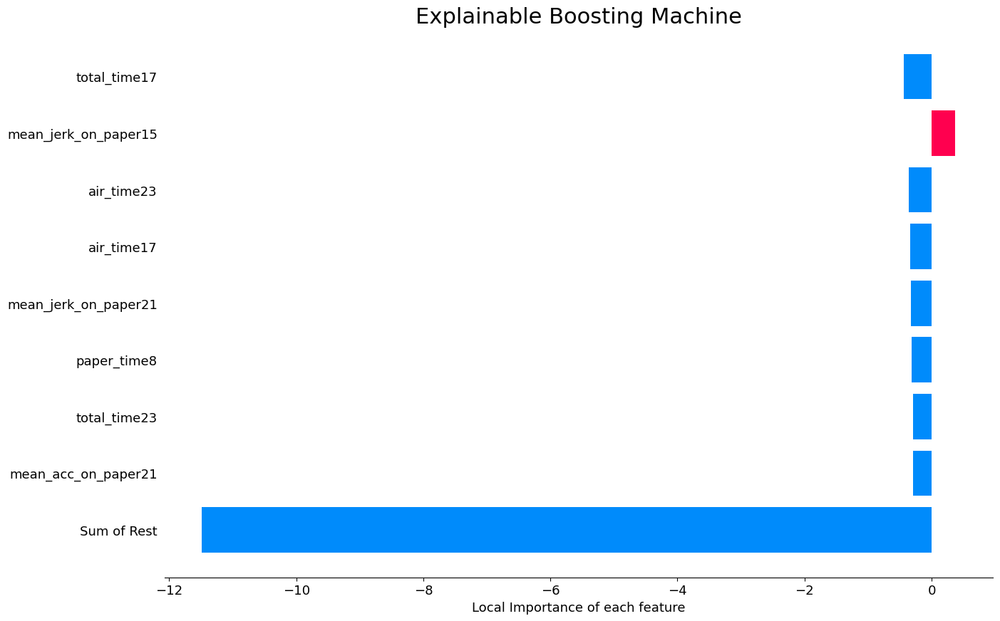

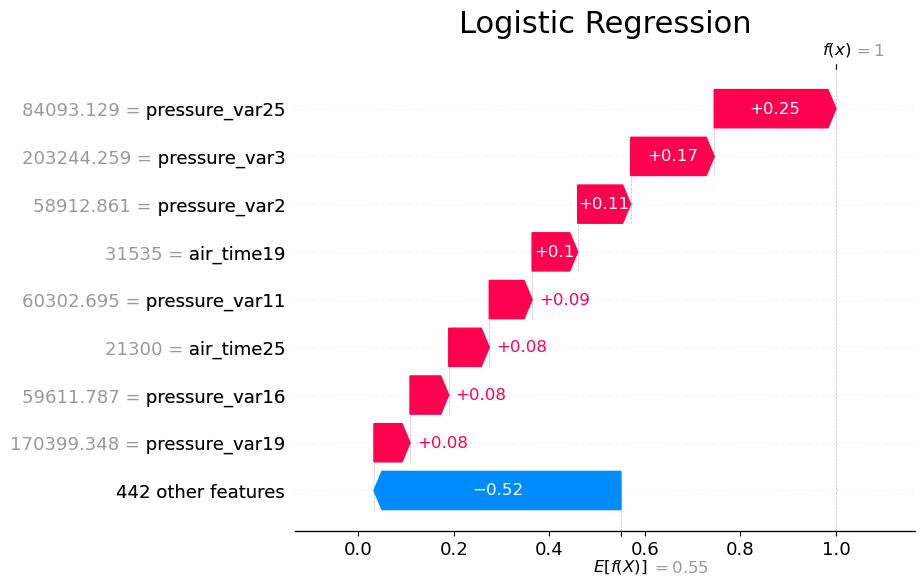

...

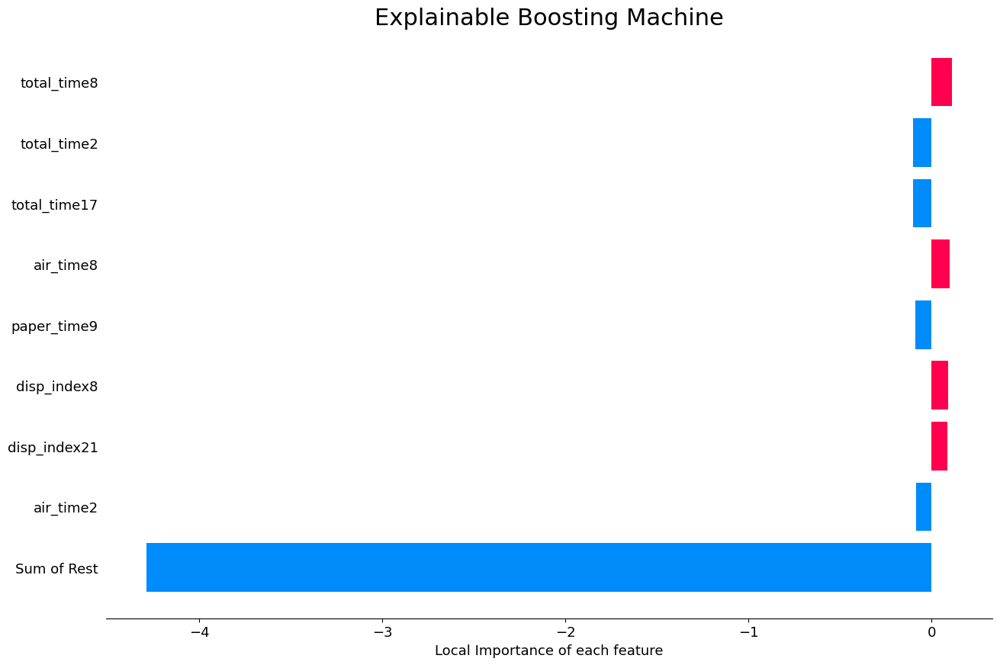

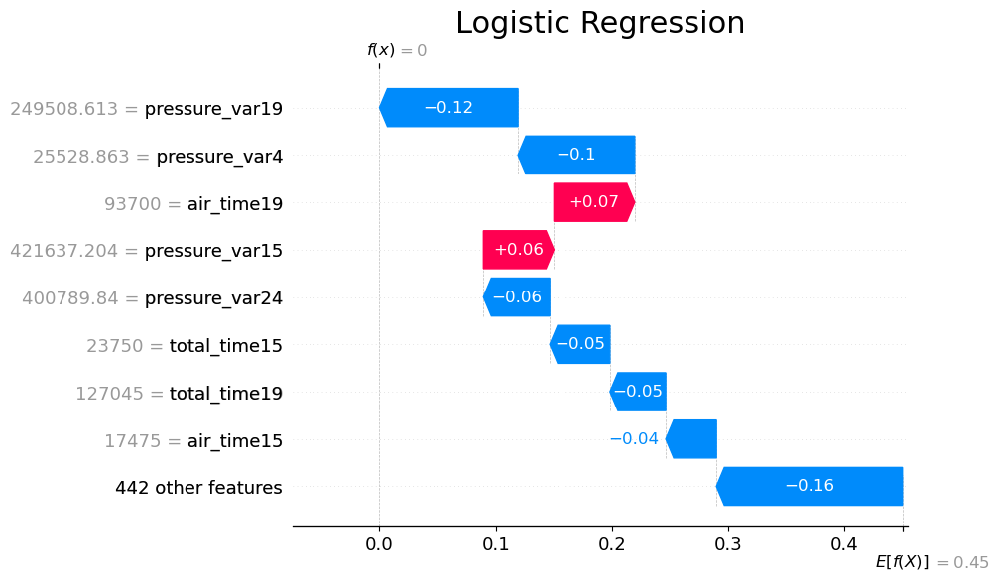

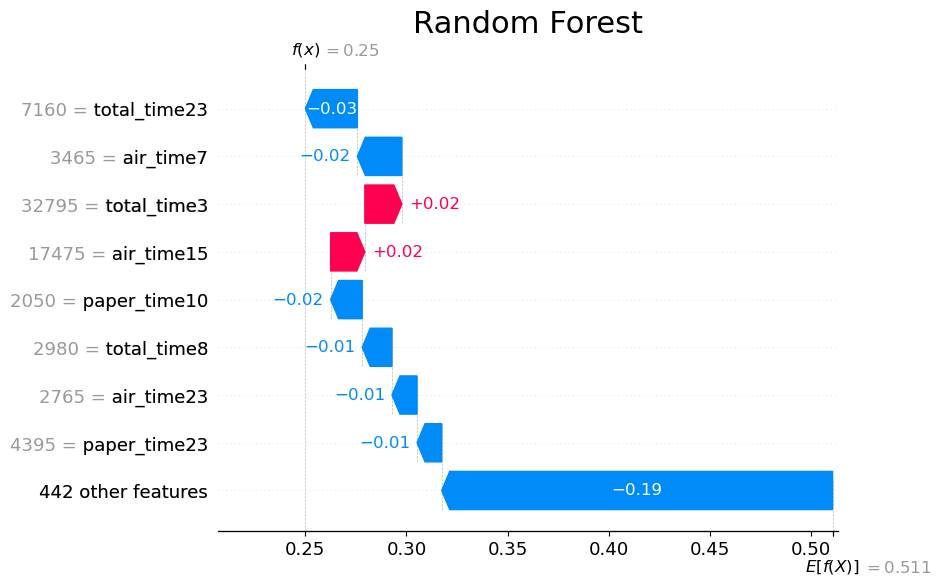

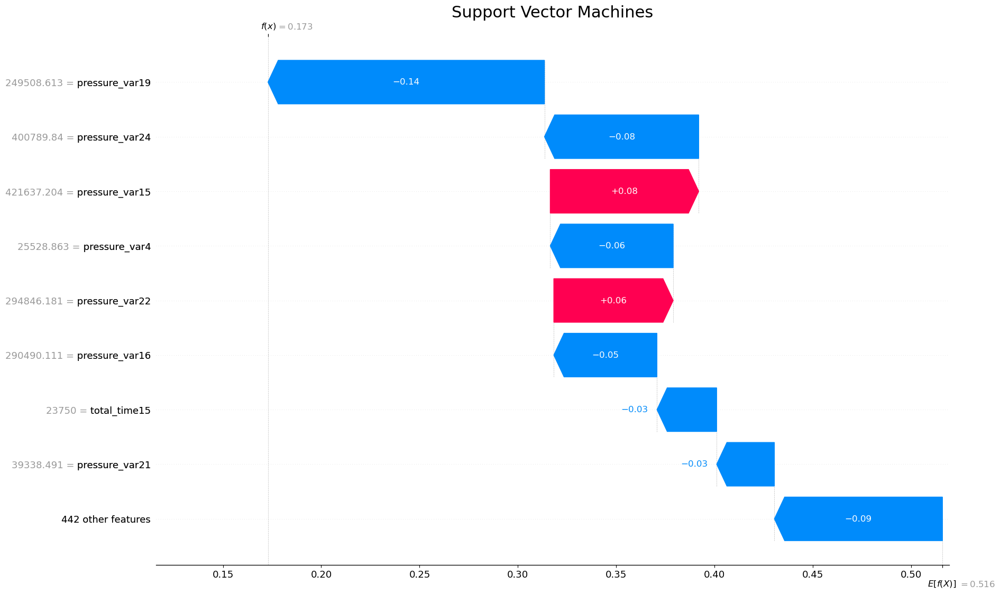

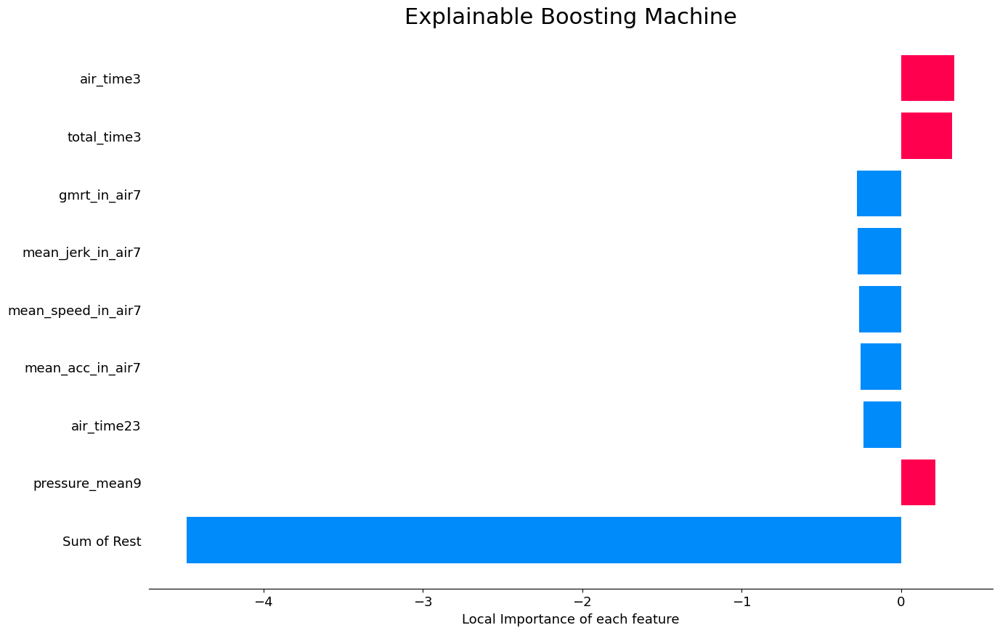

In [51]:
for i in range(sss_nsplits):
    Exp_inst_pd = X_tests_pd[i].iloc[Exp_index]
    
    lr_shap_loc_values = np.array(lr_shaps[i].shap_values(Exp_inst_pd))
    rf_shap_loc_values = np.array(rf_shaps[i].shap_values(Exp_inst_pd))
    svm_shap_loc_values = np.array(svm_shaps[i].shap_values(Exp_inst_pd))
    
    explanations = [shap.Explanation(lr_shap_loc_values[1, :], lr_shaps[i].expected_value[1], data=Exp_inst_pd),
                shap.Explanation(rf_shap_loc_values[1, :], rf_shaps[i].expected_value[1], data=Exp_inst_pd),
                shap.Explanation(svm_shap_loc_values[1, :], svm_shaps[i].expected_value[1], data=Exp_inst_pd)]
    
    ebm_local = ebm_clfs[i].explain_local(X_tests_pd[i], Y_tests[i])
    
    visual.local_shap(explanations, 
                      ebm_local.data(key=Exp_index),
                      nrows = 2,
                      ncols = 2,
                      figsize = (15,10),
                      title_size = 22,
                      label_size = label_size,
                      titles = ["Logistic Regression", "Random Forest", "Support Vector Machines"],
                      ebm_colors = shap_colors / 255,
                      num_features=9,
                      save_name=f"{logs_dir}/darwin_local_SHAP_EBM_{i}")
    
    plt.show()


## Global Explanations

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

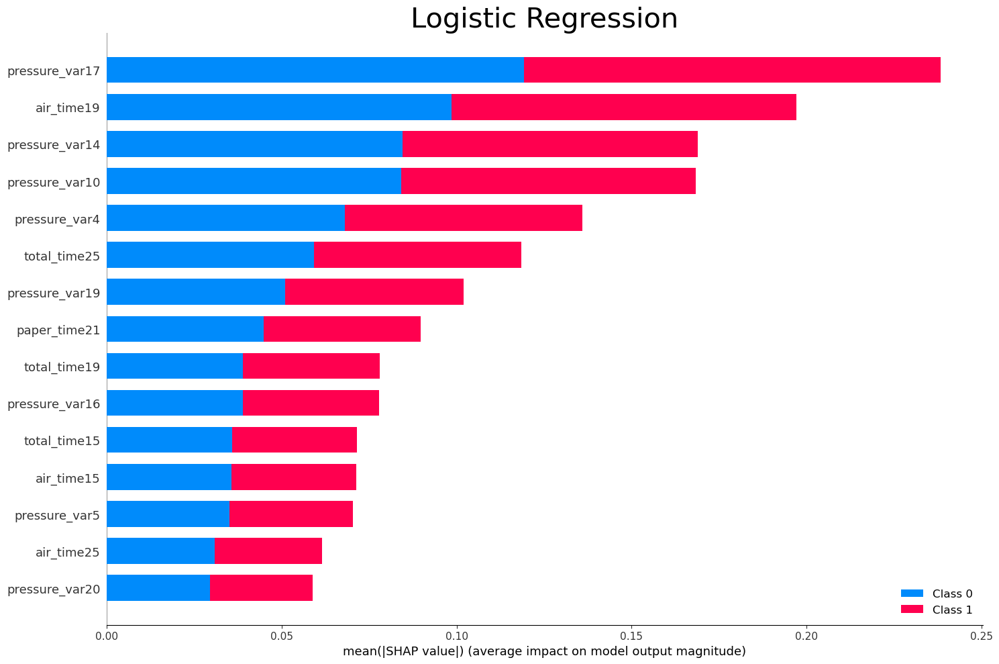

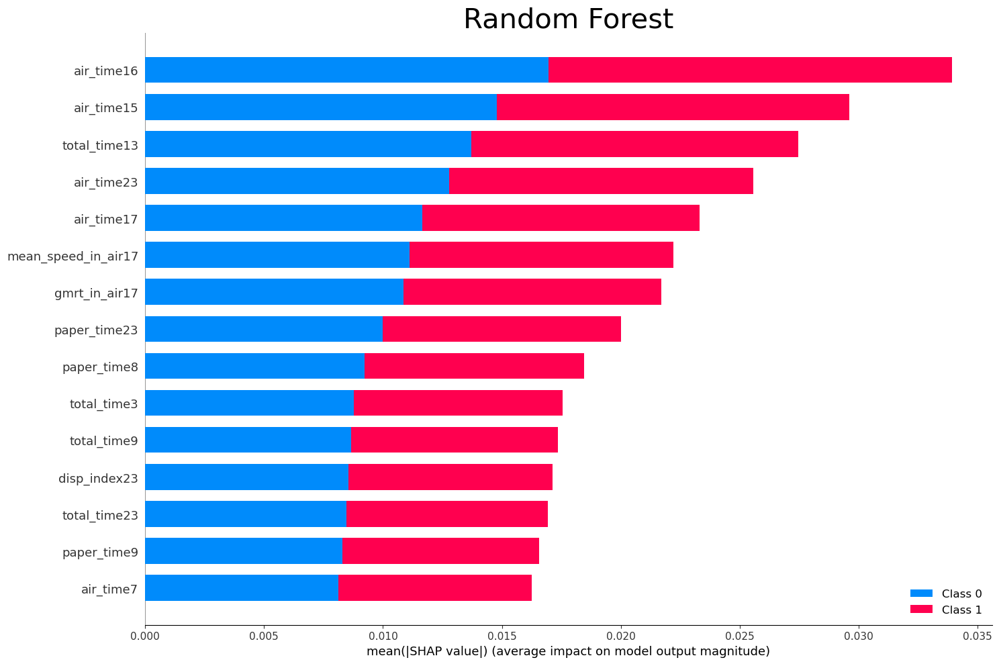

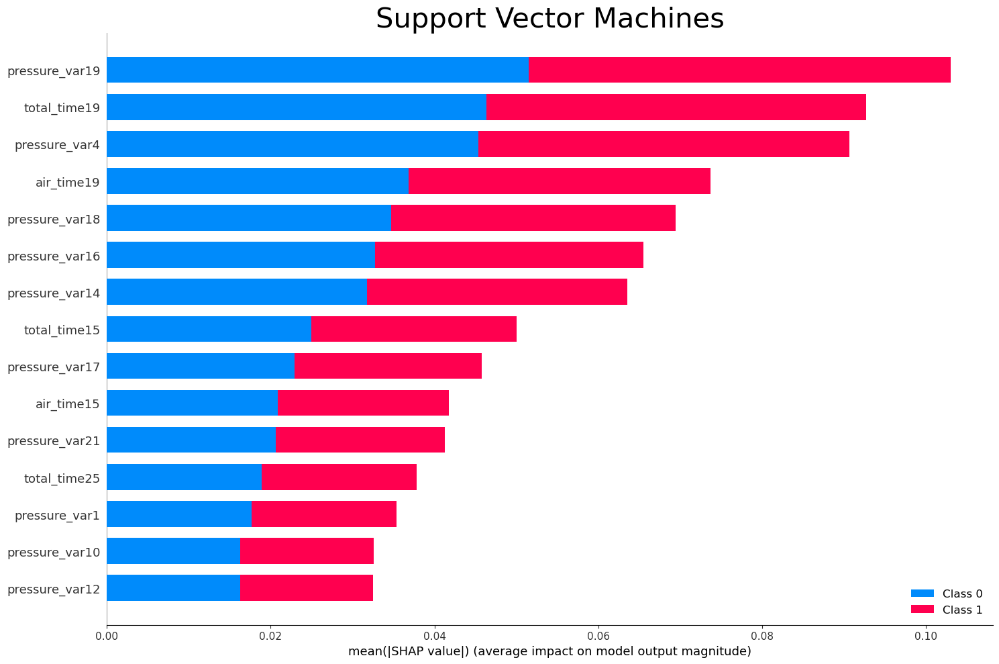

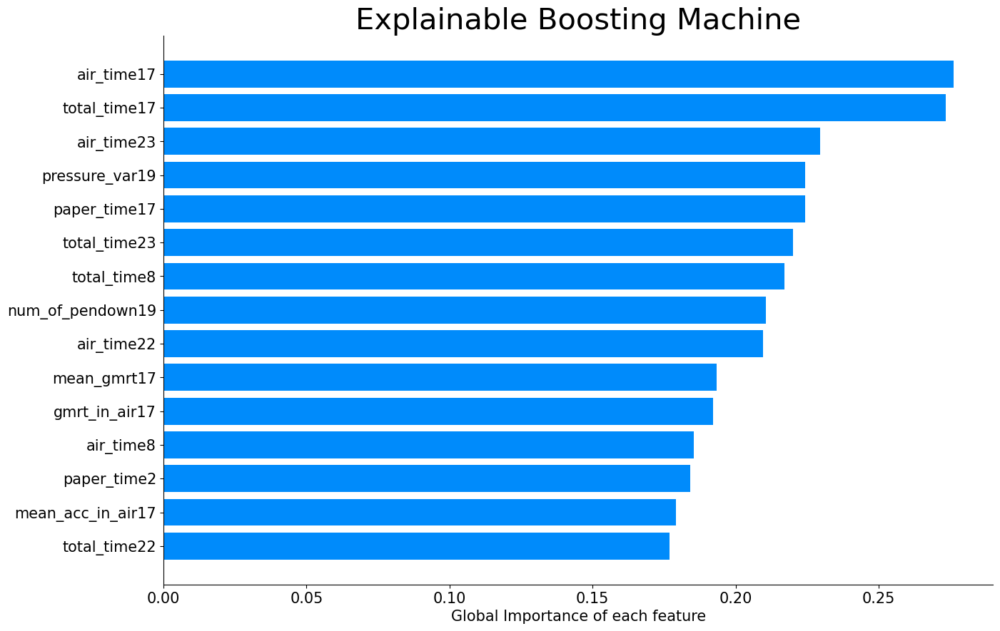

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

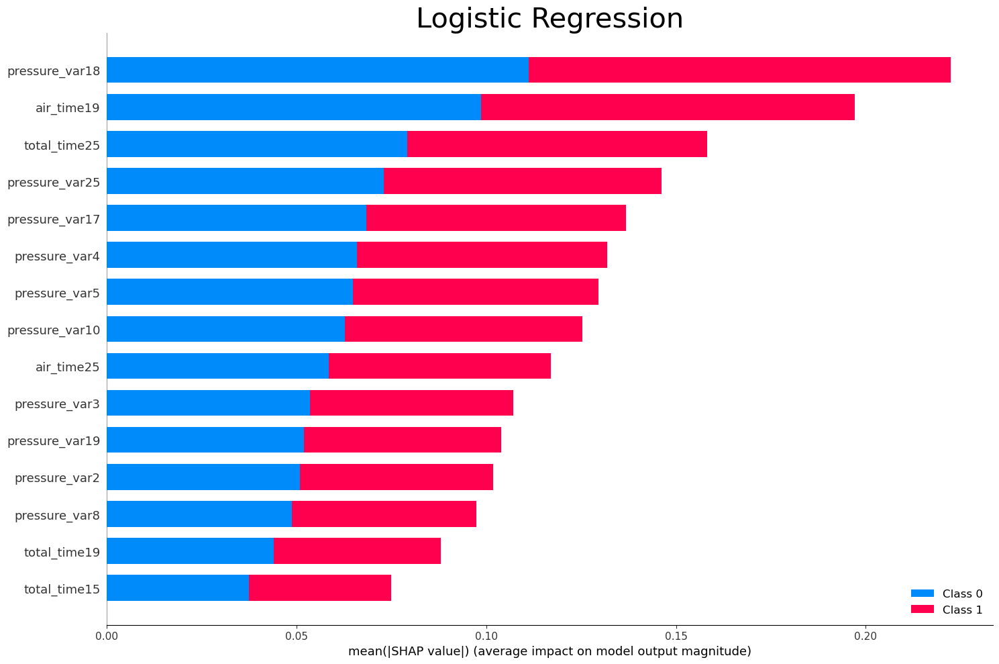

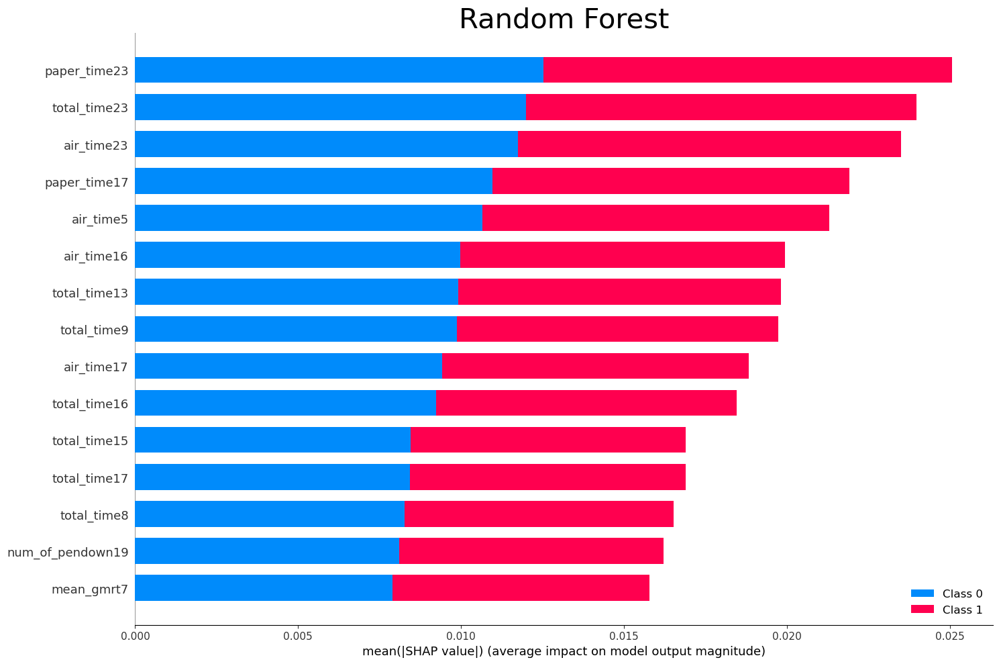

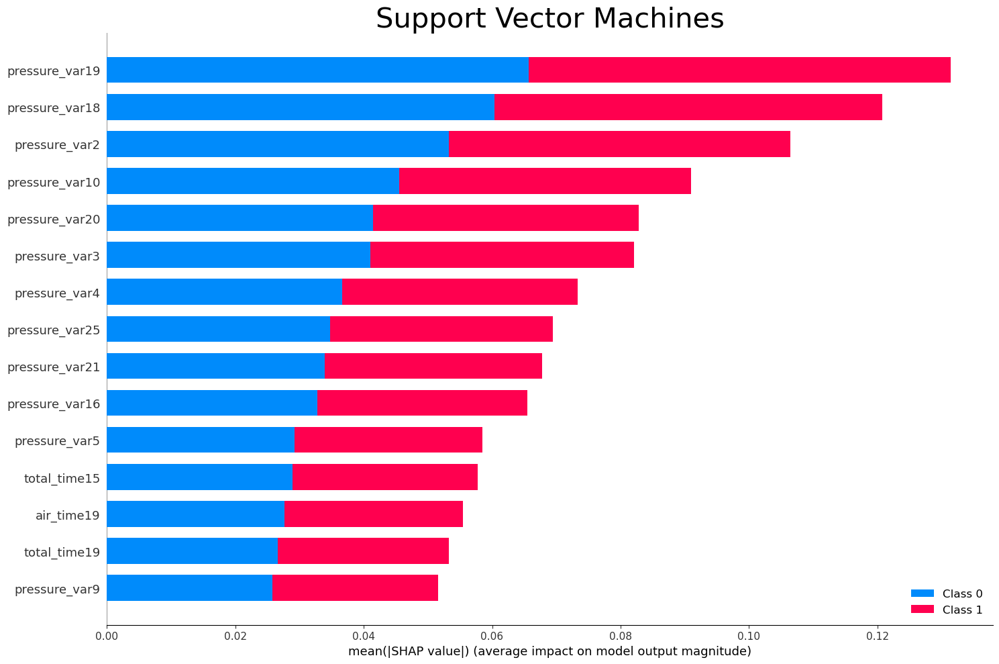

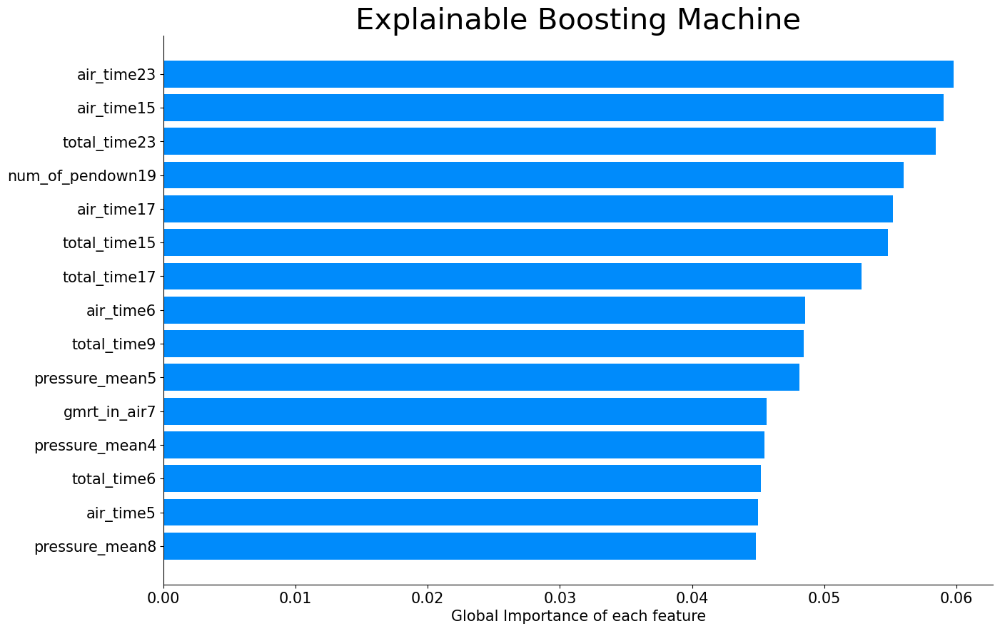

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

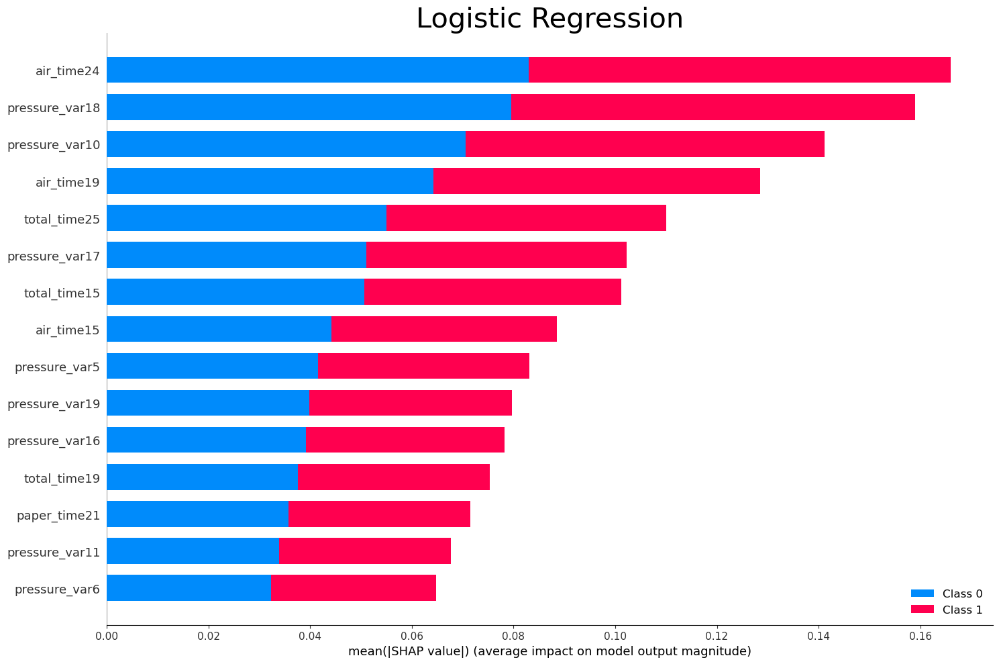

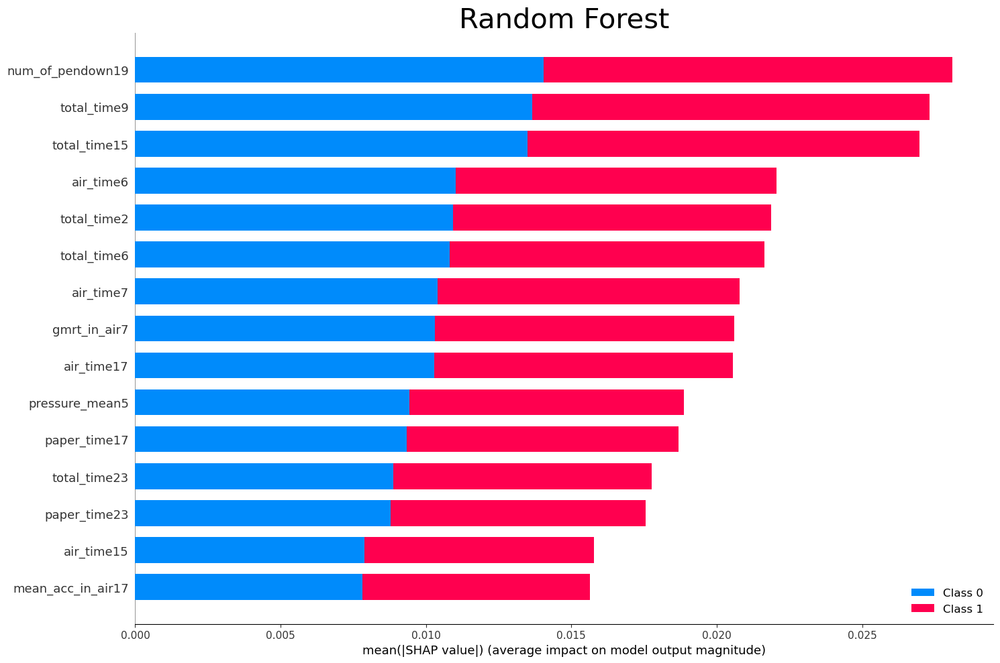

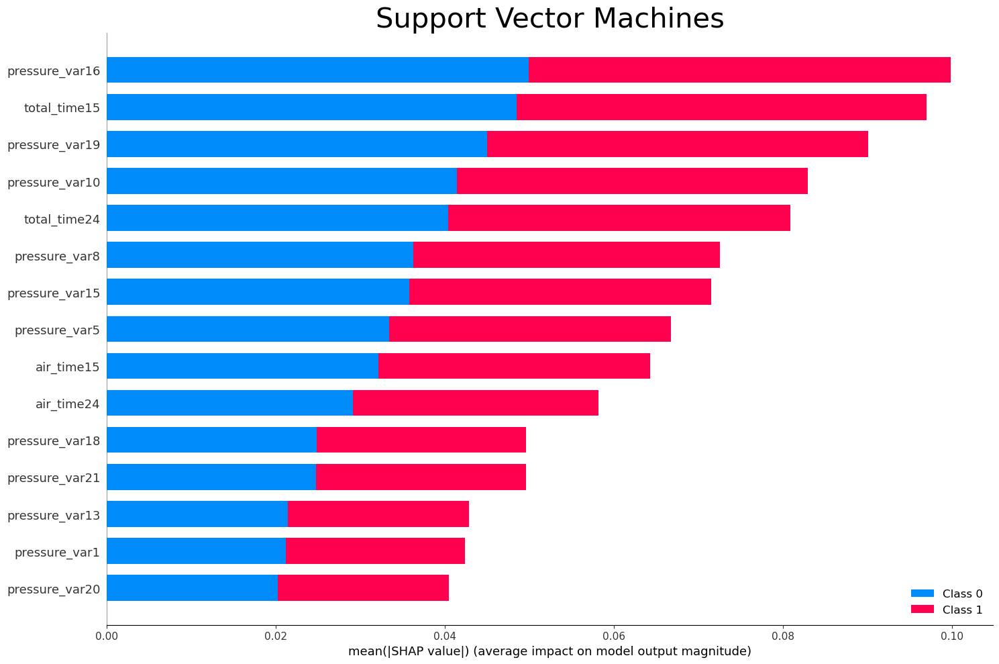

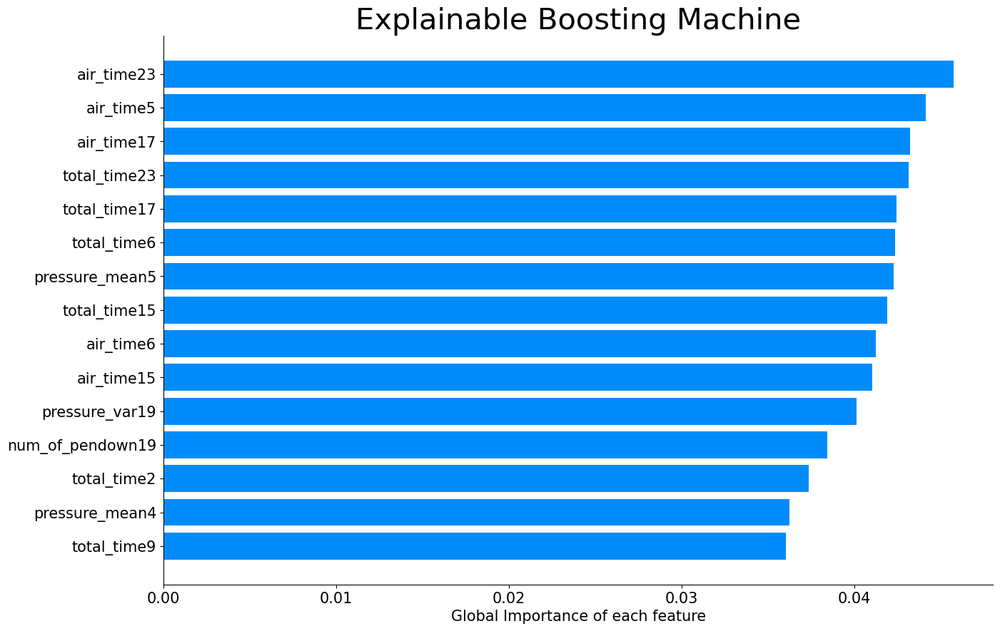

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

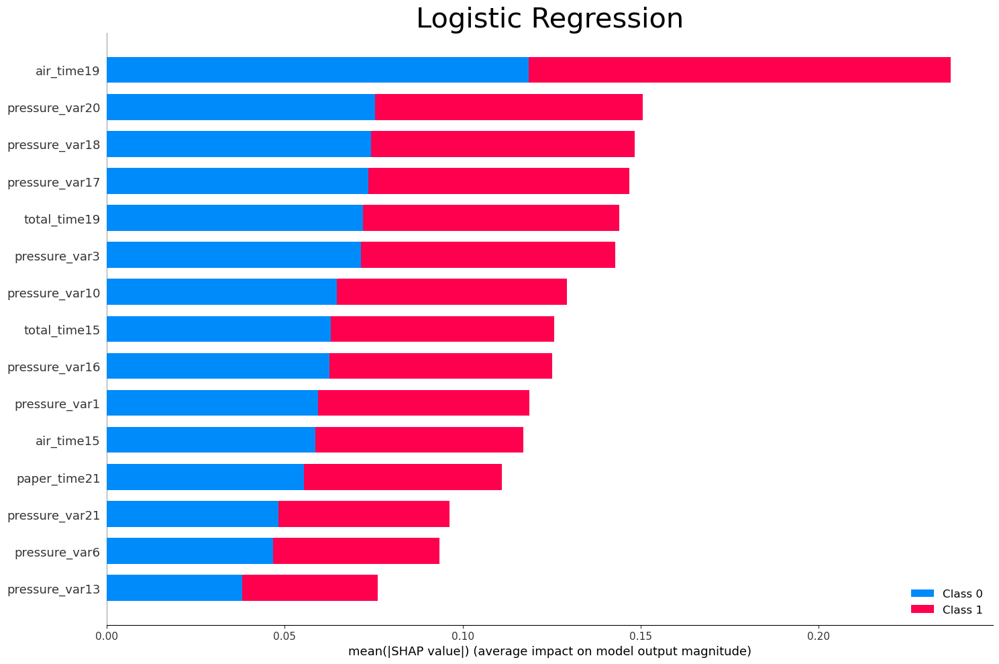

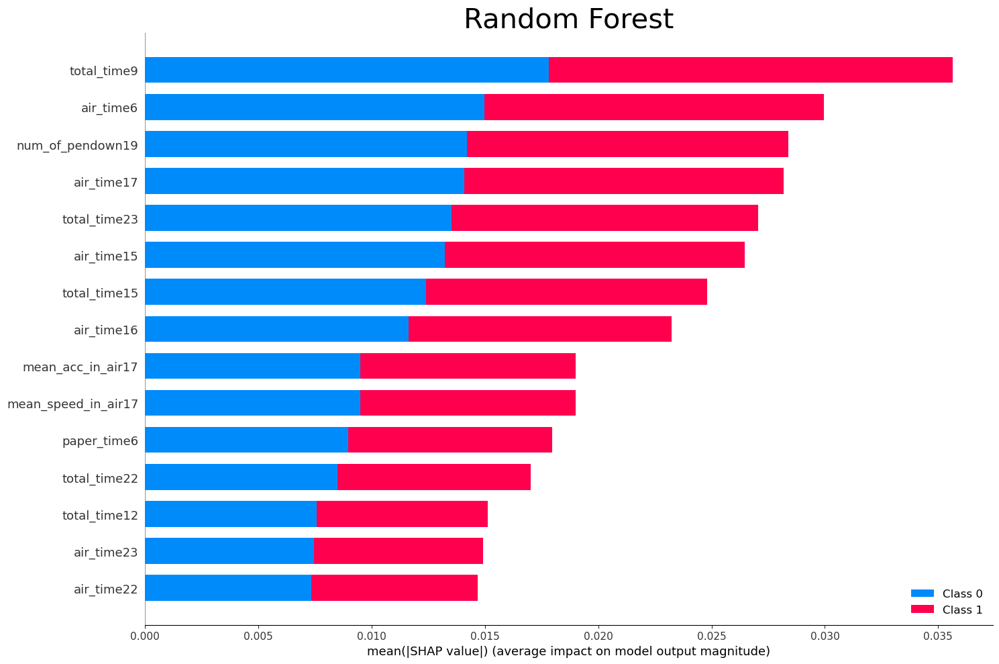

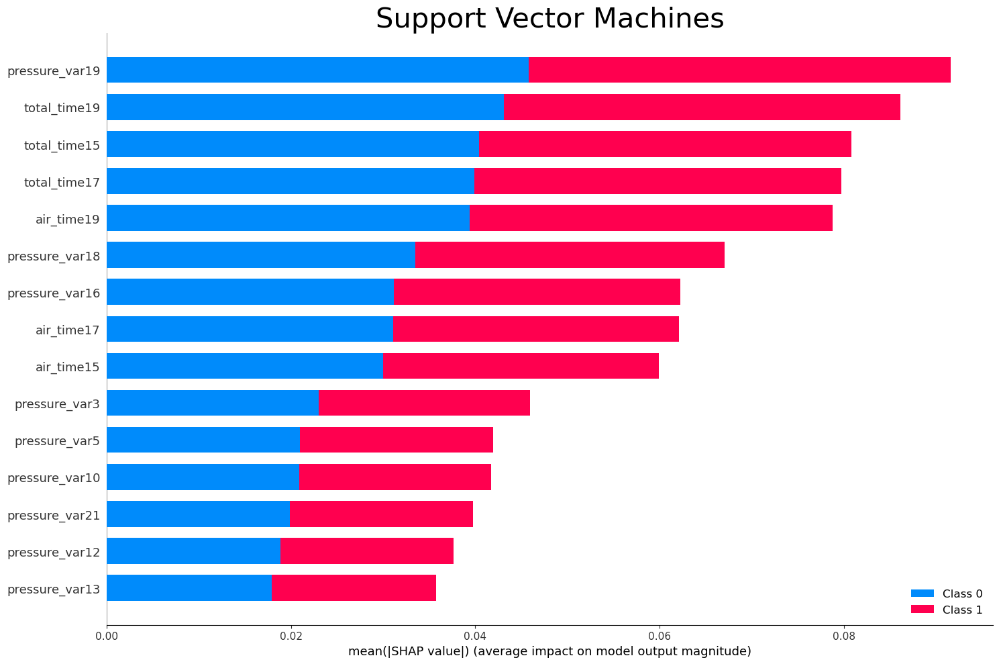

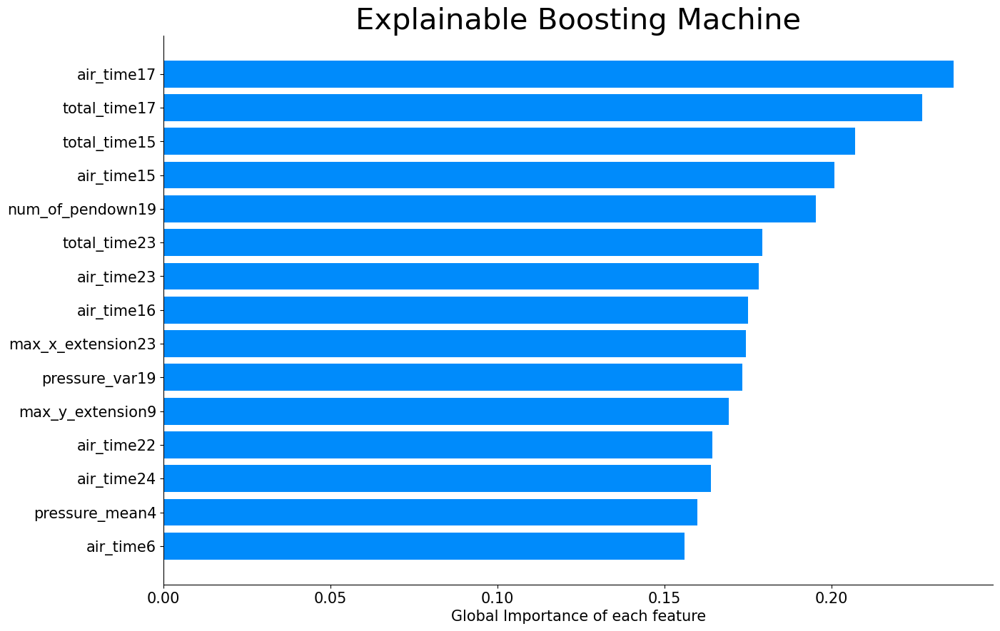

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

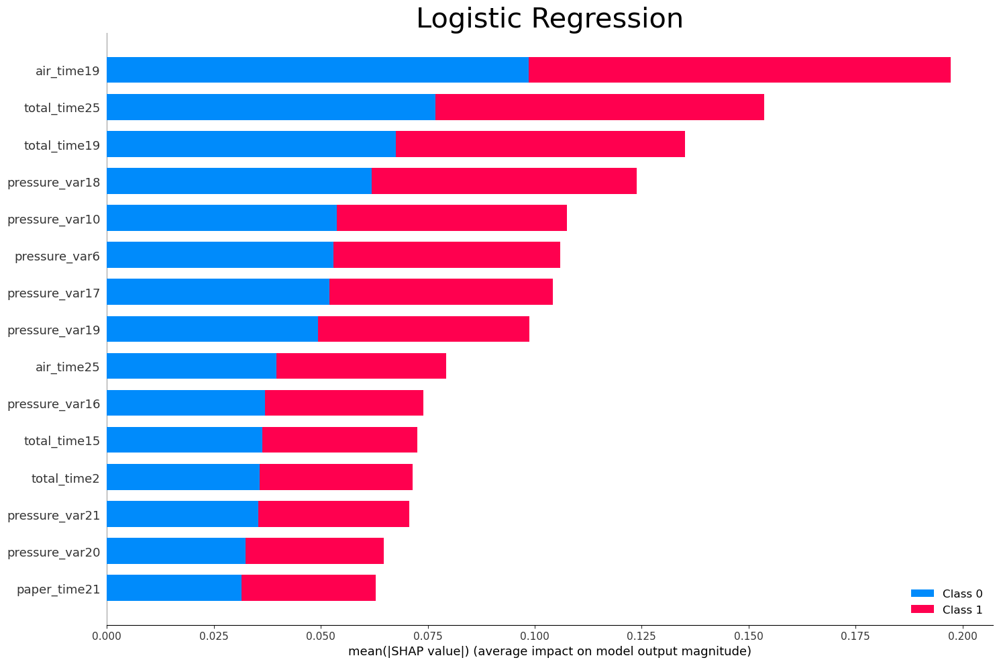

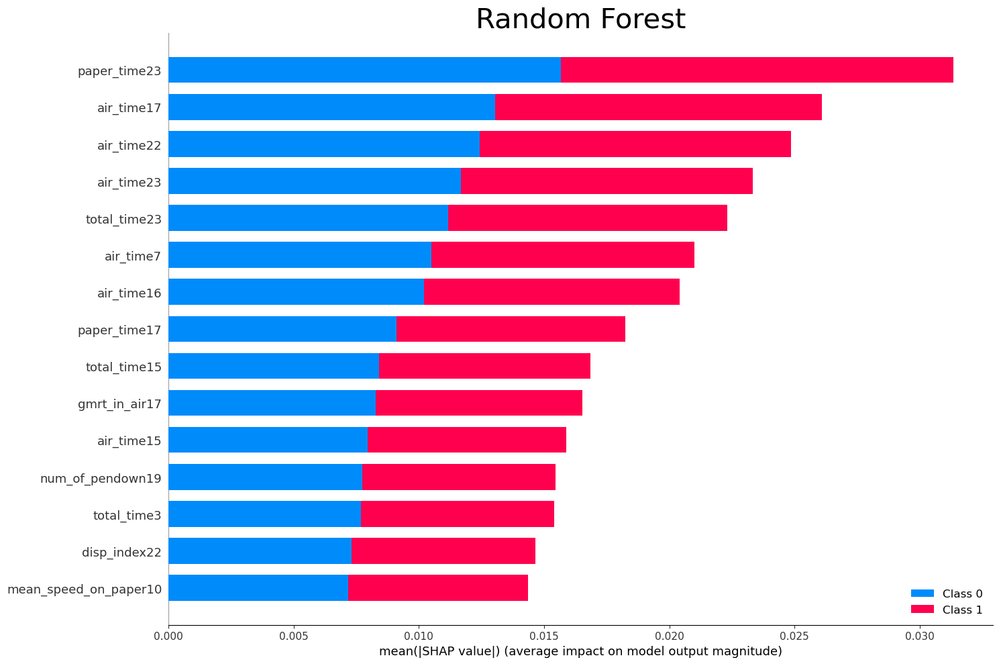

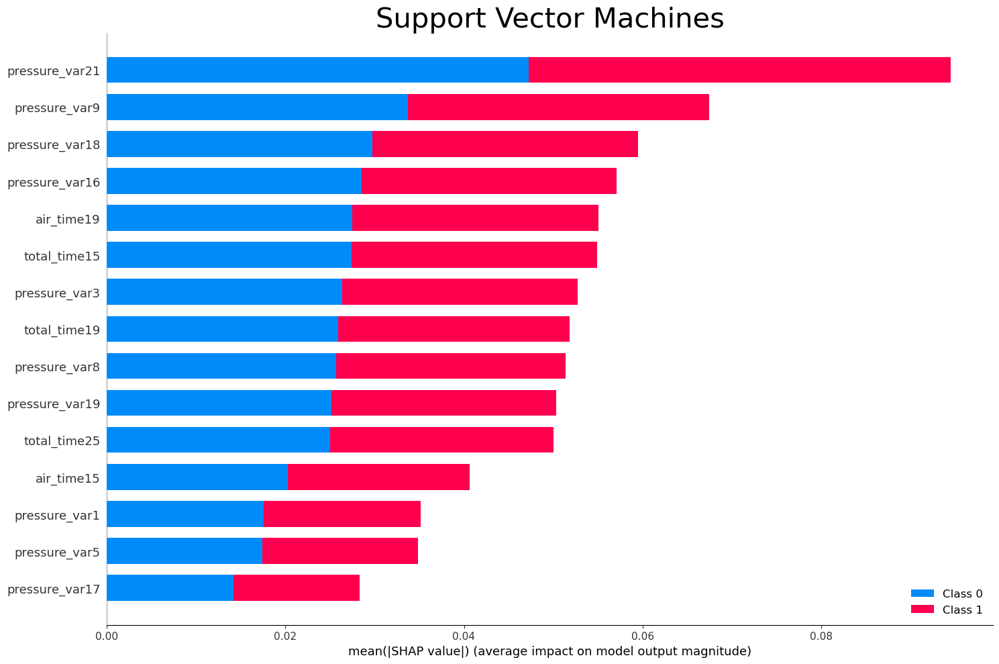

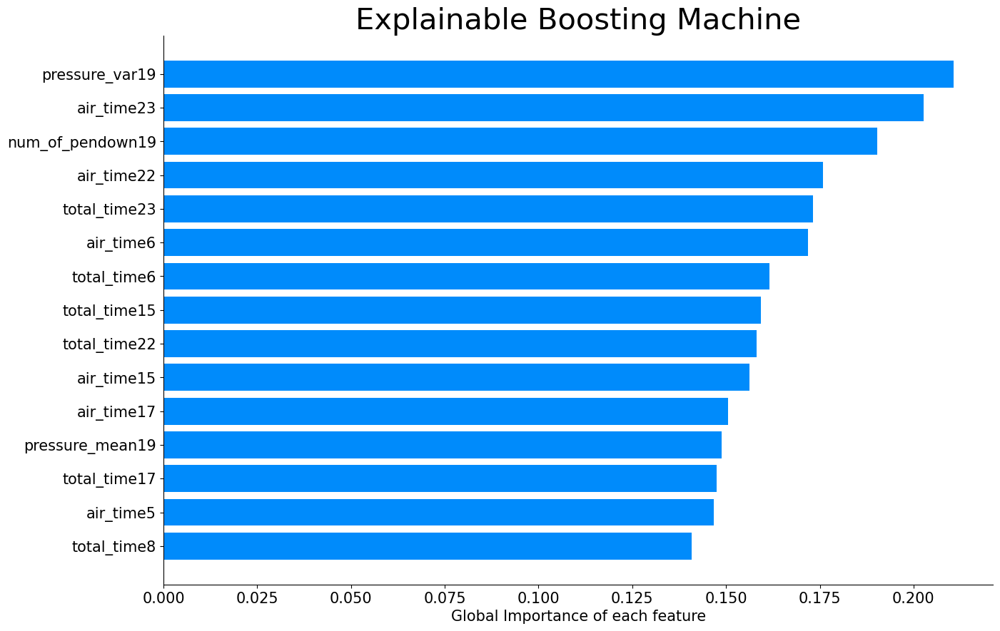

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

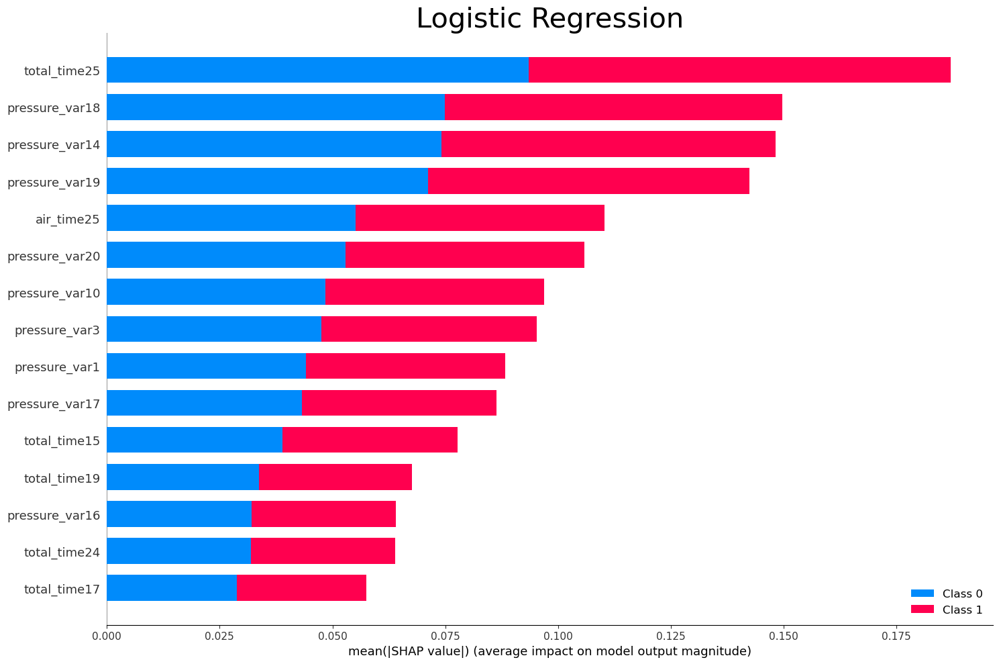

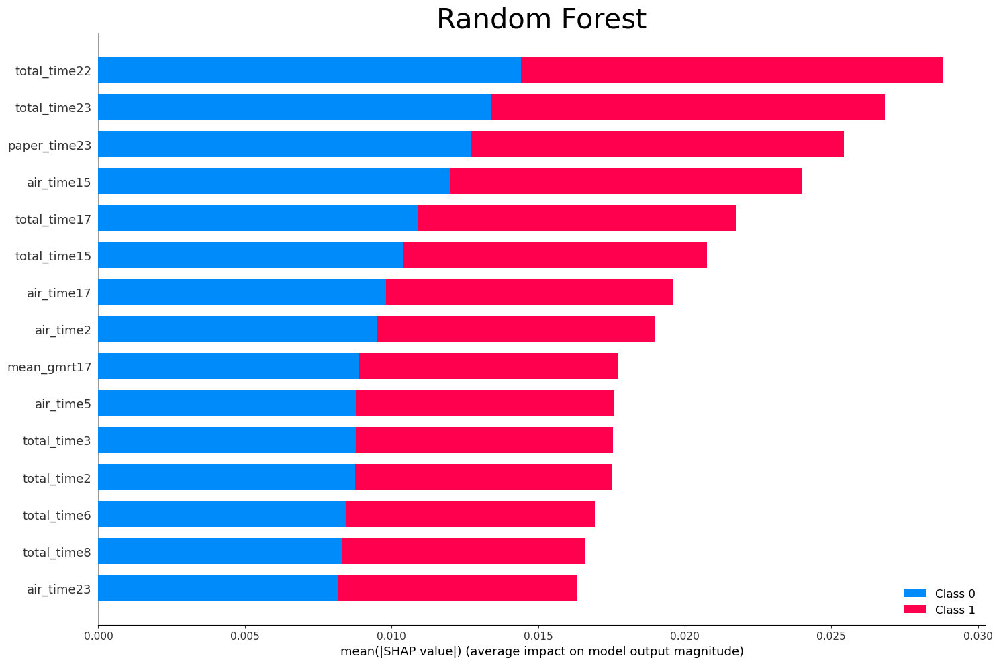

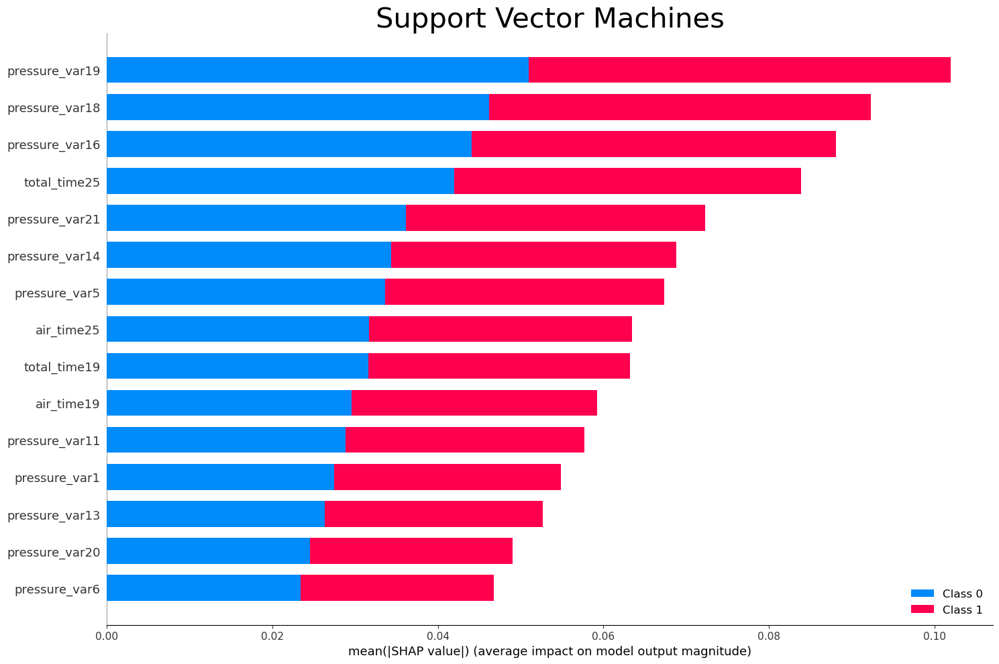

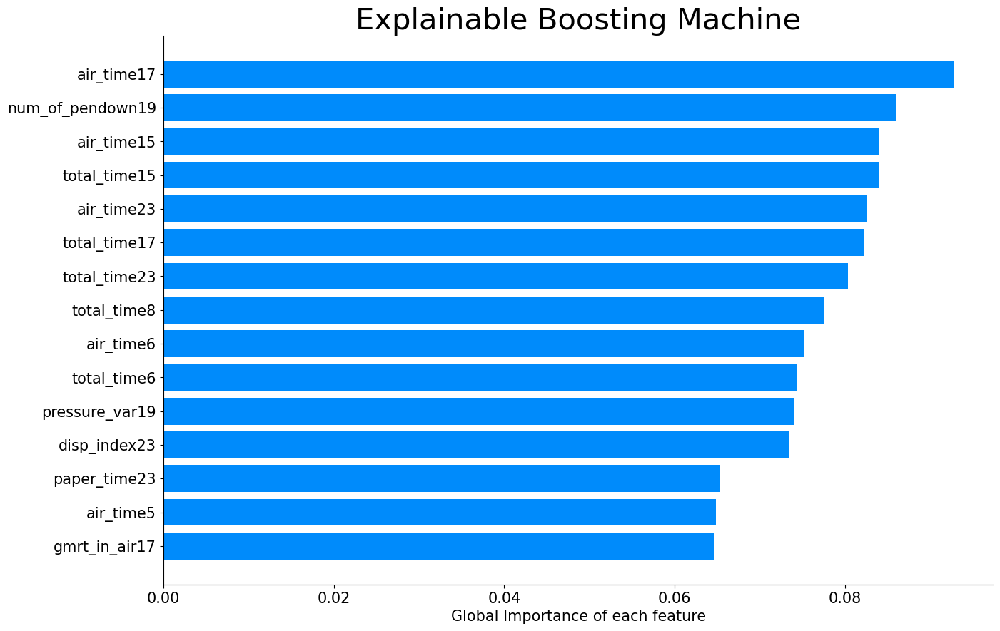

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

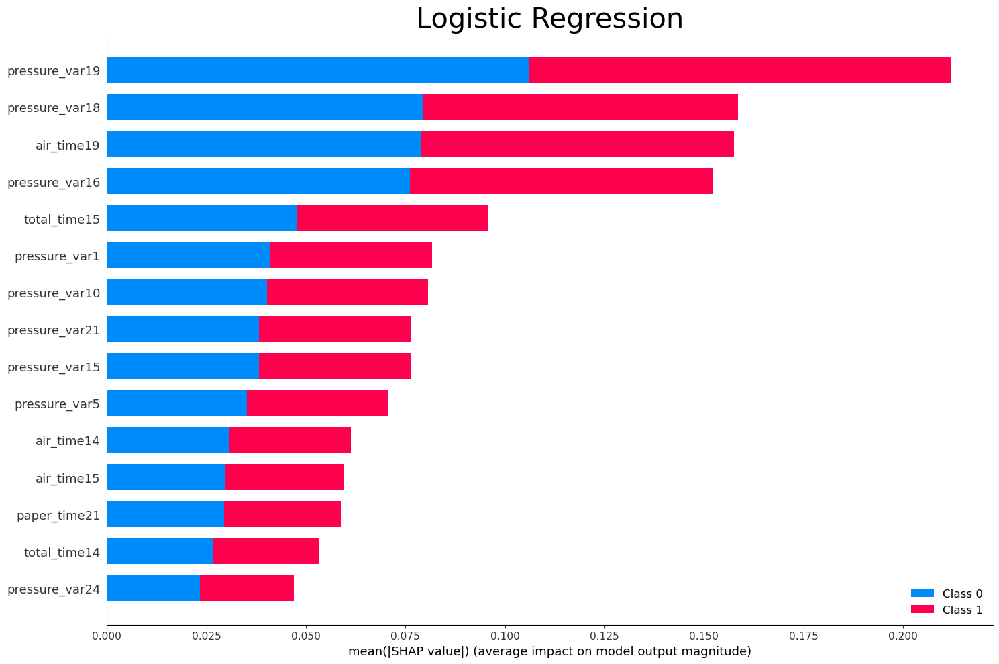

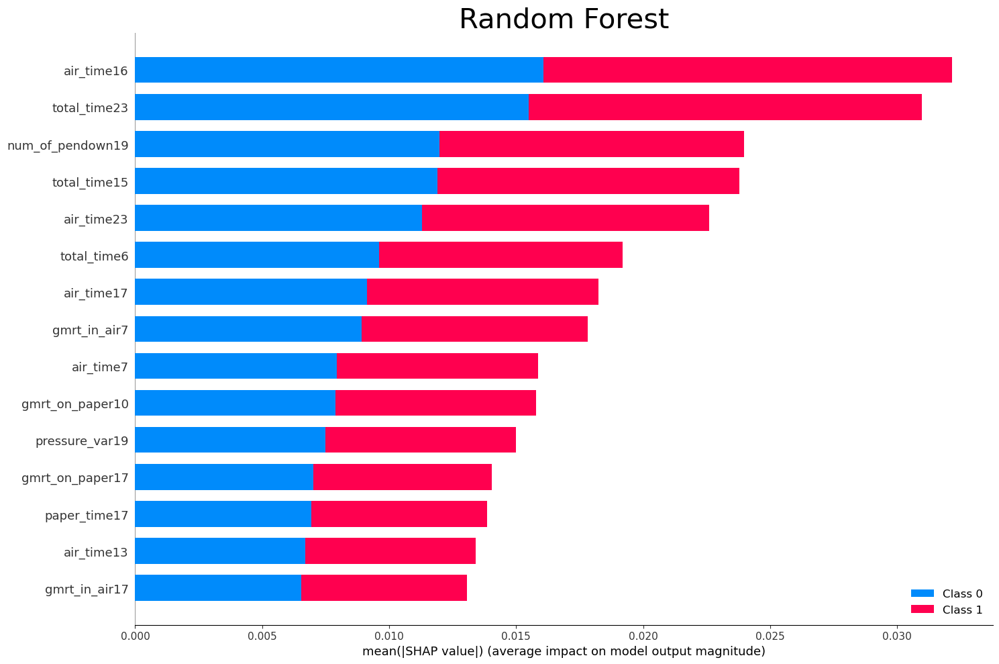

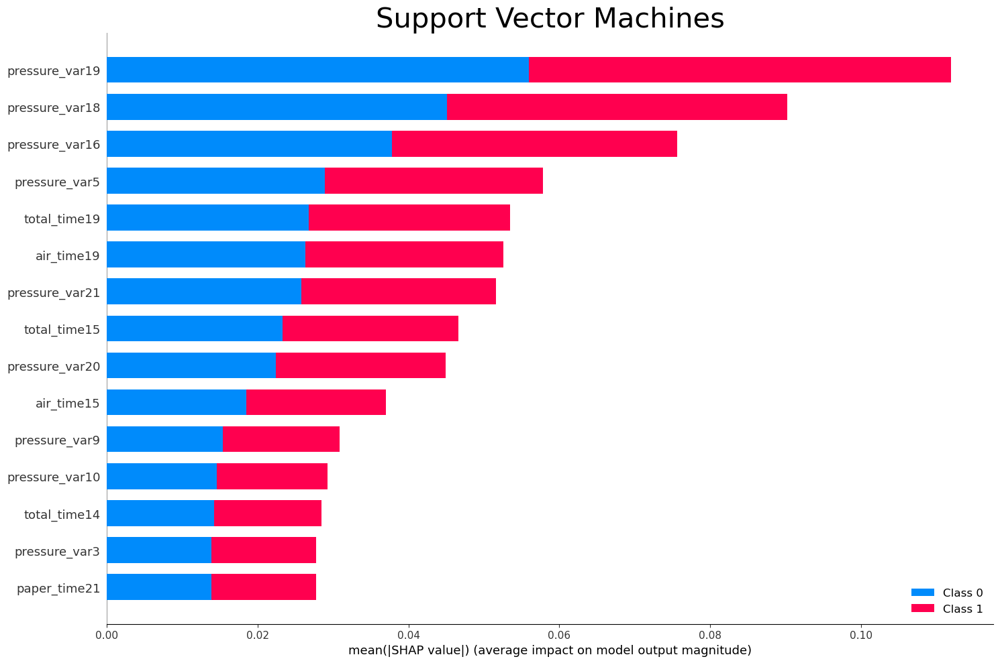

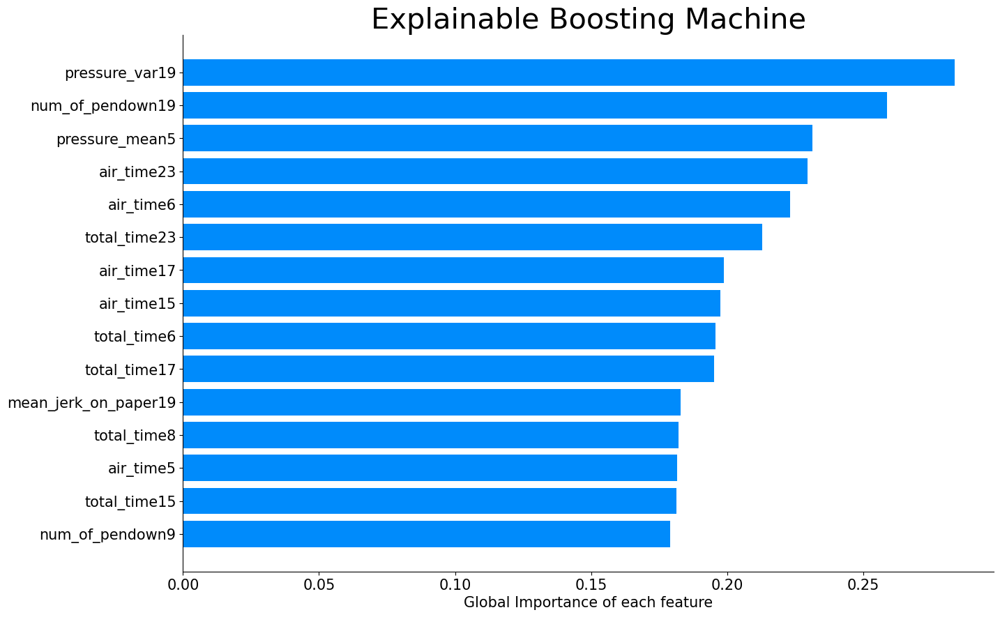

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

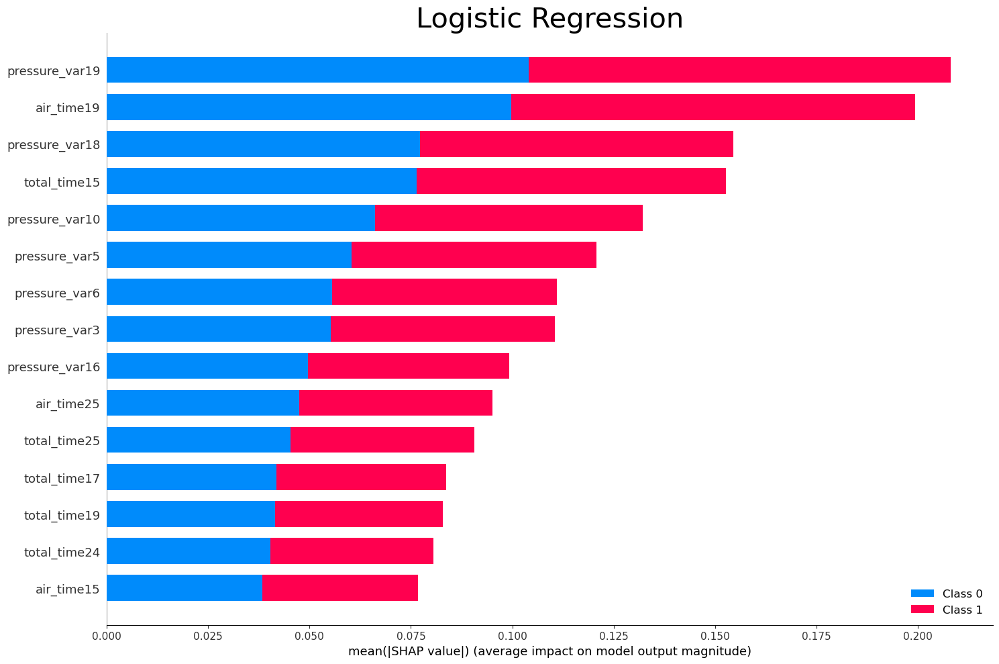

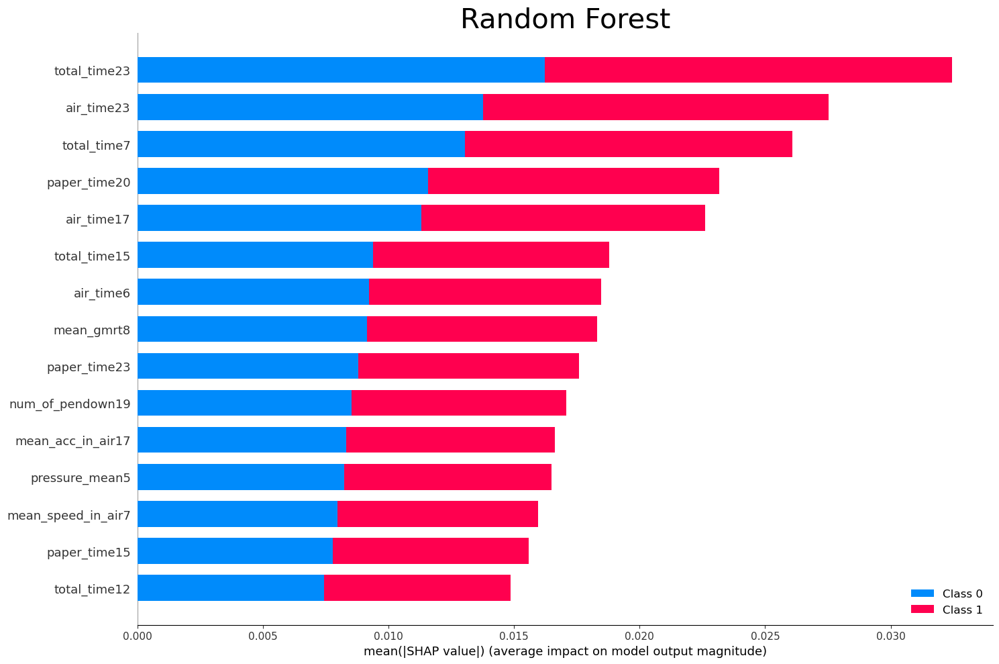

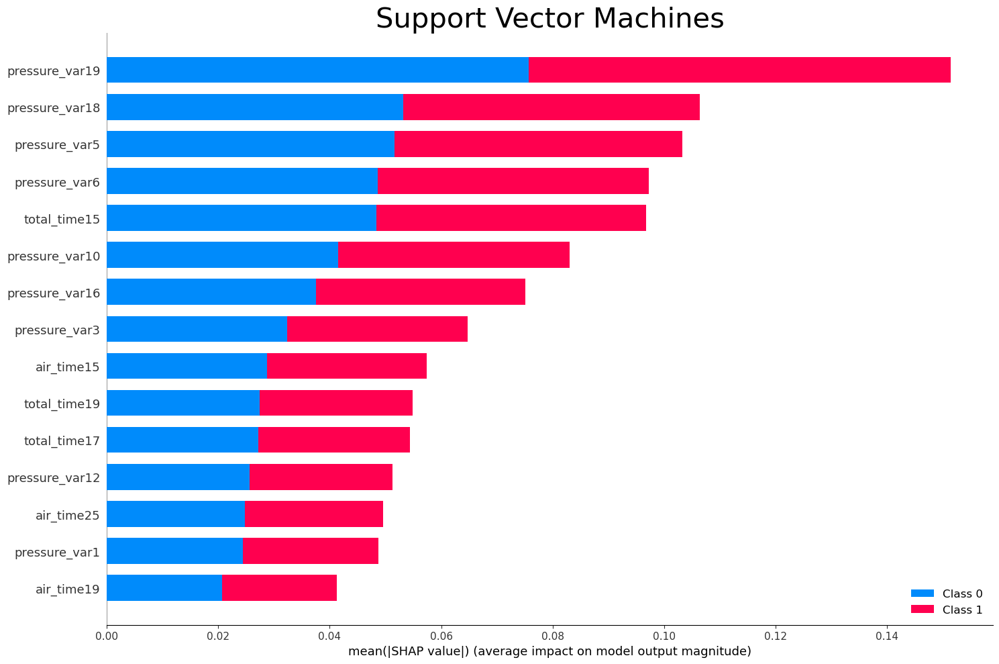

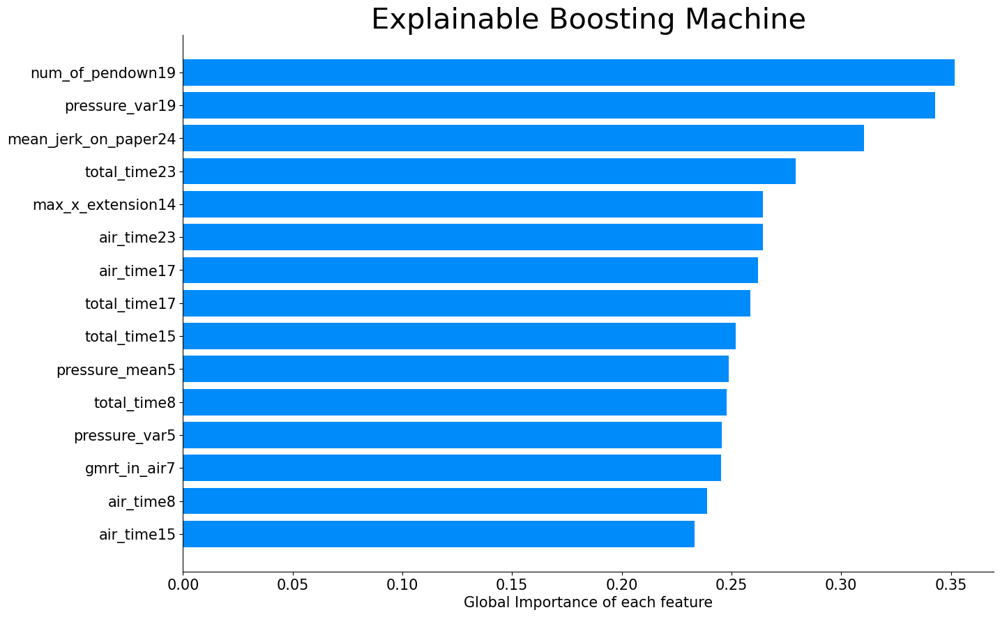

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

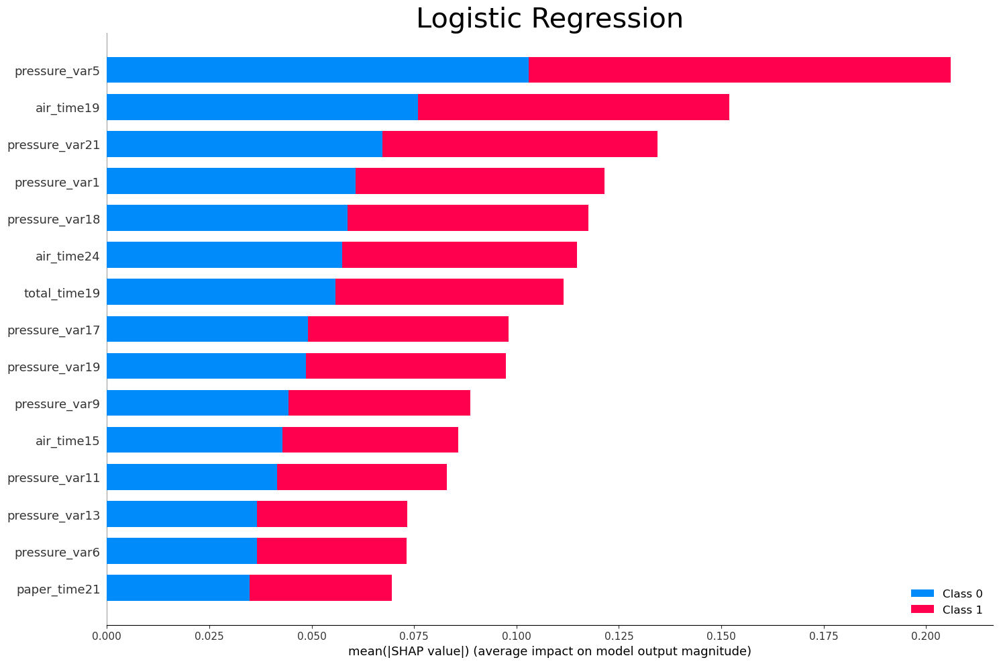

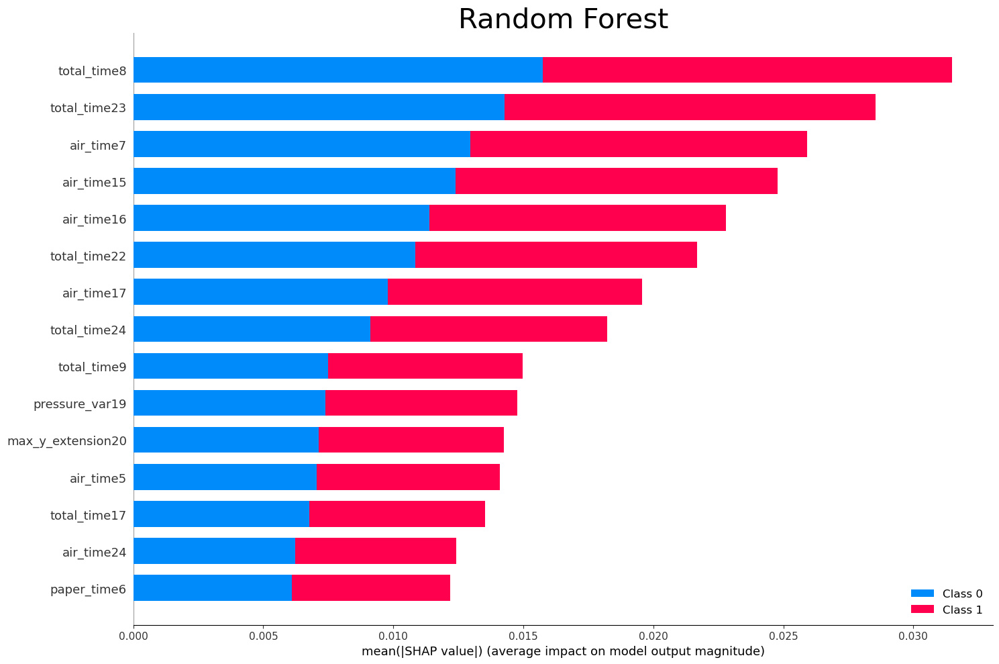

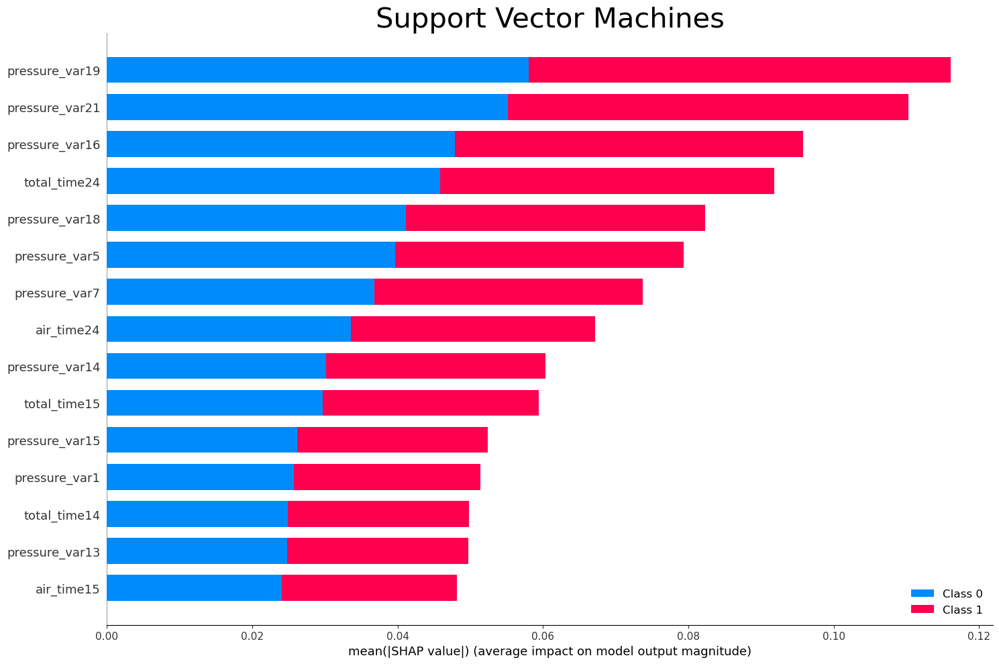

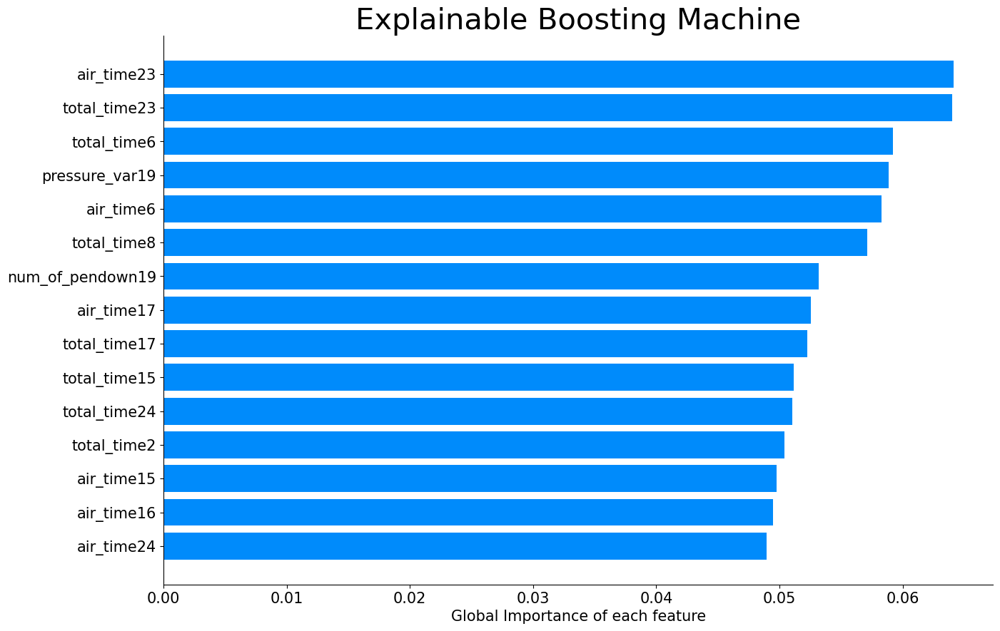

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

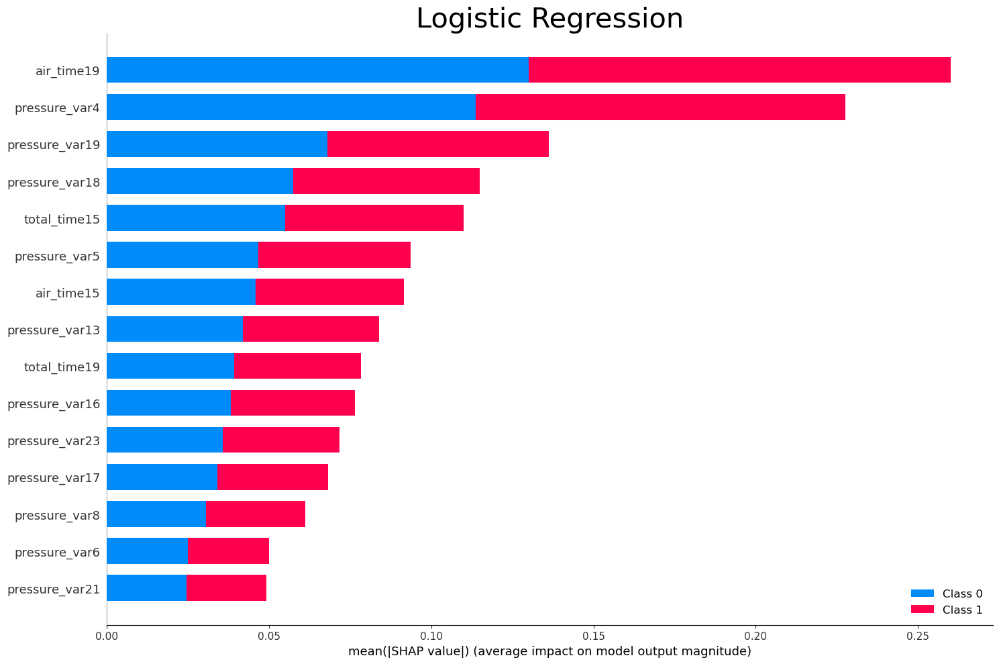

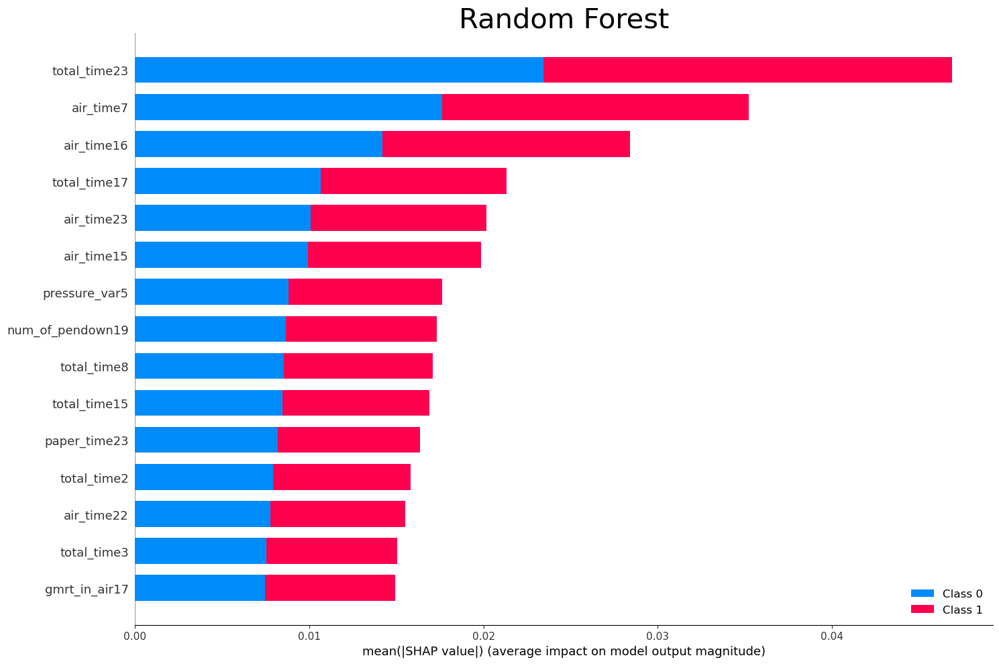

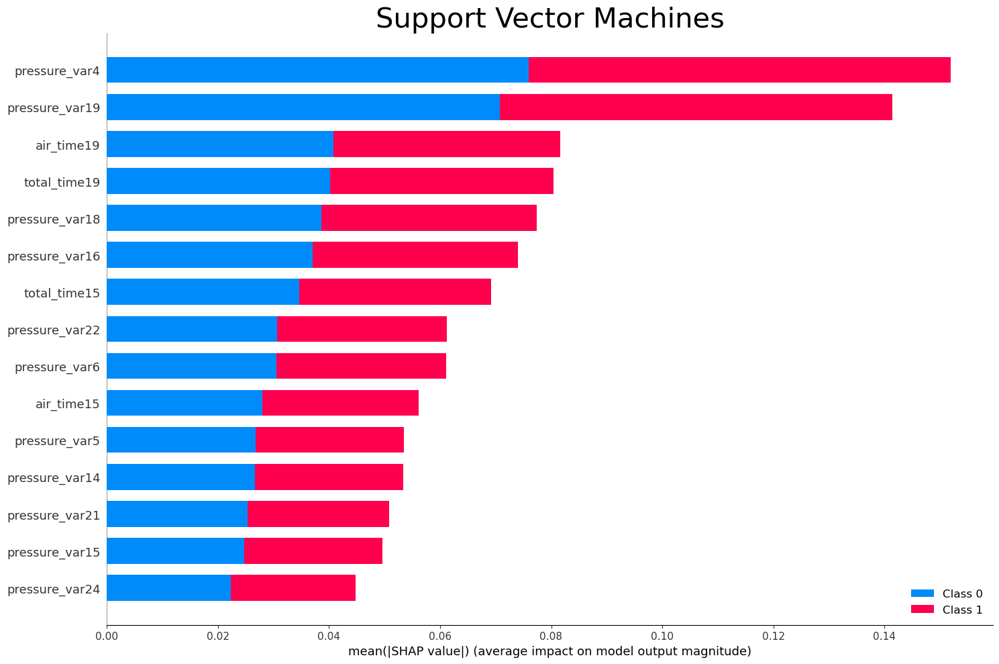

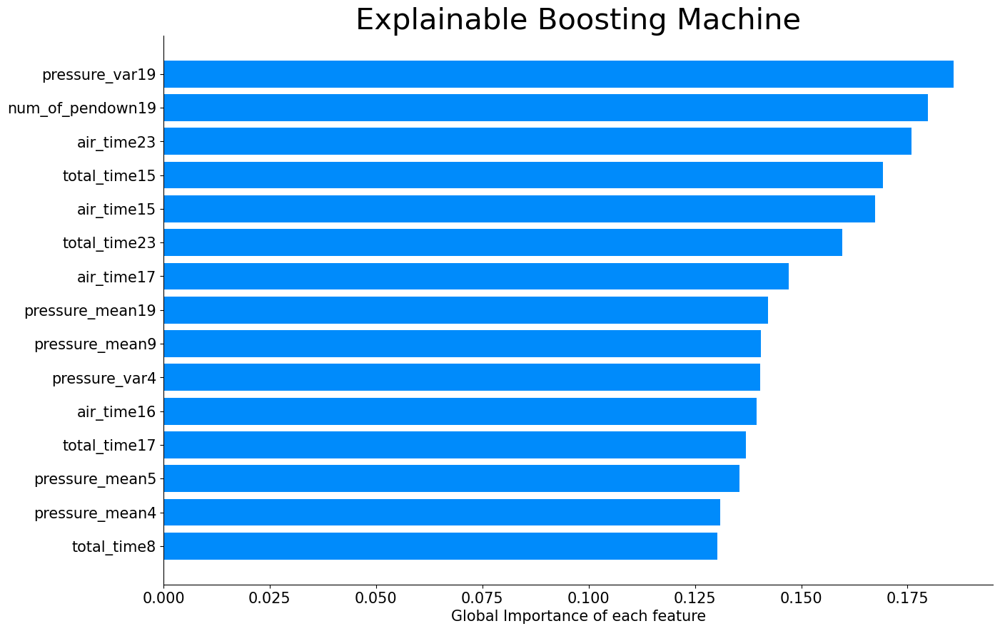

In [52]:
for i in range(sss_nsplits):
    lr_shap_global_values = lr_shaps[i].shap_values(X_tests_pd[i])
    rf_shap_global_values = rf_shaps[i].shap_values(X_tests_pd[i])
    svm_shap_global_values = svm_shaps[i].shap_values(X_tests_pd[i])
    
    global_shap_values = [lr_shap_global_values,
                      rf_shap_global_values,
                      svm_shap_global_values]
    
    ebm_global = ebm_clfs[i].explain_global()

    visual.global_shap(global_shap_values,
                       X_tests_pd[i],
                       ebm_global.data(),
                       nrows = 2,
                       ncols = 2,
                       figsize = (15, 10),
                       title_size = 30,
                       label_size = 15,
                       titles = ["Logistic Regression", "Random Forest", "Support Vector Machines"],
                       ebm_colors = shap_colors/255,
                       num_features=15,
                       save_name=f"{logs_dir}/darwin_global_SHAP_EBM_{i}")
    
    plt.show()